# 노이즈 종류에 따른 성능 편차 비교

모든 드리프트 현상에 대해 일관성 있는 성능 개선의 효과를 관측 가능한가<br>
<br>
추론하고자 하는 대상 데이터에 주입된 노이즈의 종류에 따라 추론성능 개선 효과의 정도 차이가 발생하는지 여부 확인
<br>
<br>
실험 대상 노이즈 종류
* Salt & Pepper<br>이미지에 랜덤한 흰&검정 점 삽입

* Motion Blur<br>화면 흔들림 효과

* JPEG Compression<br>화질 깨짐 현상, 해상도 변화

* Bright<br>더 밝은 이미지

* Dark<br>더 어두운 이미지


In [13]:
## 노이즈 주입 함수 준비

import cv2
import numpy as np

def add_noise(image, noise_type='gaussian', params=None):
    """
    다양한 종류의 노이즈를 추가하는 함수
    
    noise_type 옵션:
    - gaussian: 가우시안 노이즈
    - salt_and_pepper: 소금-후추 노이즈
    - poisson: 포아송 노이즈
    - speckle: 스펙클 노이즈
    - periodic: 주기적 노이즈
    - motion_blur: 모션 블러
    - jpeg_compression: JPEG 압축 노이즈
    - brightness_contrast: 밝기와 대비 조정
    """
    if params is None:
        params = {}
    
    noisy = np.copy(image)
    
    if noise_type == "gaussian":
        # 가우시안 노이즈: 정규 분포를 따르는 랜덤 노이즈
        mean = params.get('mean', 0)
        sigma = params.get('sigma', 25)
        gauss = np.random.normal(mean, sigma, image.shape)
        noisy = np.clip(image + gauss, 0, 255).astype(np.uint8)
    
    elif noise_type == "salt_and_pepper":
        # 소금-후추 노이즈: 랜덤하게 흰점과 검은점을 추가
        prob = params.get('prob', 0.05)
        rnd = np.random.random(image.shape)
        noisy[rnd < prob/2] = 0    # 후추 노이즈
        noisy[rnd > 1 - prob/2] = 255  # 소금 노이즈
    
    elif noise_type == "poisson":
        # 포아송 노이즈: 이미지 센서에서 발생하는 노이즈
        vals = len(np.unique(image))
        vals = 2 ** np.ceil(np.log2(vals))
        noisy = np.random.poisson(image * vals) / float(vals)
        noisy = np.clip(noisy, 0, 255).astype(np.uint8)
    
    elif noise_type == "speckle":
        # 스펙클 노이즈: 레이더나 초음파 이미지에서 발생하는 노이즈
        intensity = params.get('intensity', 0.1)
        gauss = np.random.normal(0, intensity, image.shape)
        noisy = np.clip(image + image * gauss, 0, 255).astype(np.uint8)
    
    elif noise_type == "periodic":
        # 주기적 노이즈: 전기적 간섭이나 센서 문제로 발생하는 주기적 패턴
        freq = params.get('freq', 0.1)
        x, y = np.meshgrid(np.arange(image.shape[1]), np.arange(image.shape[0]))
        noise = 20 * np.sin(2 * np.pi * freq * x) + 20 * np.sin(2 * np.pi * freq * y)
        noisy = np.clip(image + noise[:, :, np.newaxis], 0, 255).astype(np.uint8)
    
    elif noise_type == "motion_blur":
        # 모션 블러: 카메라나 피사체의 움직임으로 인한 블러
        size = params.get('size', 15)
        angle = params.get('angle', 45)
        kernel = np.zeros((size, size))
        kernel[int((size-1)/2), :] = np.ones(size)
        kernel = cv2.warpAffine(kernel, 
                              cv2.getRotationMatrix2D((size/2, size/2), angle, 1.0), 
                              (size, size))
        kernel = kernel / size
        noisy = cv2.filter2D(image, -1, kernel)
    
    elif noise_type == "jpeg_compression":
        # JPEG 압축 노이즈: 이미지 압축으로 인한 품질 저하
        quality = params.get('quality', 50)
        encode_param = [int(cv2.IMWRITE_JPEG_QUALITY), quality]
        _, encimg = cv2.imencode('.jpg', image, encode_param)
        noisy = cv2.imdecode(encimg, 1)

    elif noise_type == "brightness_contrast":
        # 밝기와 대비 조정
        brightness = params.get('brightness', 0)  # -100 ~ 100
        contrast = params.get('contrast', 1.0)    # 0.0 ~ 3.0
        
        # 대비 조정
        noisy = cv2.convertScaleAbs(noisy, alpha=contrast, beta=brightness)
    
    return noisy

## Salter & Pepper 데이터셋 생성

Current, Test 데이터셋 생성

### 데이터 노이즈 주입 테스트

In [2]:
import os

data_path = "../datasets/tunelpdr_merged_all"
img_path = os.path.join(data_path, "images")
splits = os.listdir(img_path)

total_files = 0

for subdir in splits:
    subdir_path = os.path.join(img_path, subdir)
    files_count = len(os.listdir(subdir_path))
    print(f'{subdir} 디렉터리 파일 갯수: {files_count}')
    total_files += files_count

print(f"전체 파일 갯수 : {total_files}")

train 디렉터리 파일 갯수: 8954
val 디렉터리 파일 갯수: 2558
test 디렉터리 파일 갯수: 1280
전체 파일 갯수 : 12792


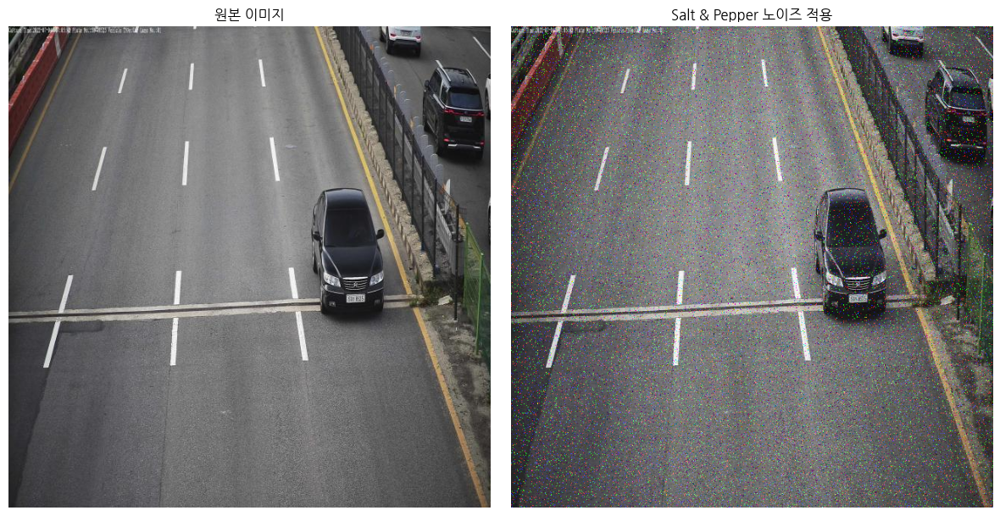

선택된 이미지 경로: ../datasets/tunelpdr_merged_all/images/test/Car_And_Plate_2023_01_18_004745_jpg.rf.d46343ceab4f24fa0a7ed15c626247fa.jpg
적용된 노이즈 강도(prob): 0.050


In [16]:
import random
import matplotlib.pyplot as plt

# 폰트 지정
plt.rc('font', family='NanumGothic')
# 랜덤한 이미지 선택
split = random.choice(splits)
split_path = os.path.join(img_path, split)
img_file = random.choice(os.listdir(split_path))
img_path_full = os.path.join(split_path, img_file)

# 이미지 로드 및 노이즈 적용
original = cv2.imread(img_path_full)
original = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)  # BGR을 RGB로 변환

# Salt & Pepper 노이즈 적용
random_prob = random.uniform(0.01, 0.1)
# random_prob = 0.05
noisy = add_noise(original, noise_type='salt_and_pepper', params={'prob': random_prob})

# 결과 시각화
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(original)
plt.title('원본 이미지')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(noisy)
plt.title('Salt & Pepper 노이즈 적용')
plt.axis('off')

plt.tight_layout()
plt.show()

print(f"선택된 이미지 경로: {img_path_full}")
print(f"적용된 노이즈 강도(prob): {random_prob:.3f}")

### Current 데이터셋 생성

일정한 노이즈 주입 (prob=0.05)

In [19]:
import shutil
import tqdm

# 새로운 데이터셋 저장 경로 설정
noise_data_path = os.path.join("../datasets", "s&p_cur")
noise_img_path = os.path.join(noise_data_path, "images")

# 기존 디렉토리가 있다면 삭제
if os.path.exists(noise_data_path):
    shutil.rmtree(noise_data_path)

# 디렉토리 구조 생성
os.makedirs(noise_data_path)
os.makedirs(noise_img_path)

# splits dir 생성
for subdir in splits:
    os.makedirs(os.path.join(noise_img_path, subdir))

# labels 디렉토리 복사
shutil.copytree(os.path.join(data_path, 'labels'), os.path.join(noise_data_path, 'labels'))
# dataset.yaml 파일 복사
shutil.copy2(os.path.join(data_path, 'dataset.yaml'), os.path.join(noise_data_path, 'dataset.yaml'))

# 가우시안 노이즈 파라미터 설정
noise_params = {
    'prob': 0.05,
}

# train과 val 디렉토리의 모든 이미지에 노이즈 적용
for subdir in splits:
    src_dir = os.path.join(img_path, subdir)
    dst_dir = os.path.join(noise_img_path, subdir)
    
    # 진행바 표시를 위한 tqdm 사용
    for img_file in tqdm.tqdm(os.listdir(src_dir), desc=f'Processing {subdir}'):
        # 이미지 로드
        img = cv2.imread(os.path.join(src_dir, img_file))
        
        # 노이즈 적용
        noisy_img = add_noise(img, 'salt_and_pepper', noise_params)
        
        # 노이즈가 적용된 이미지 저장
        cv2.imwrite(os.path.join(dst_dir, img_file), noisy_img)

print("노이즈가 적용된 데이터셋 생성 완료!")

Processing test: 100%|██████████| 1280/1280 [00:12<00:00, 106.60it/s]

노이즈가 적용된 데이터셋 생성 완료!


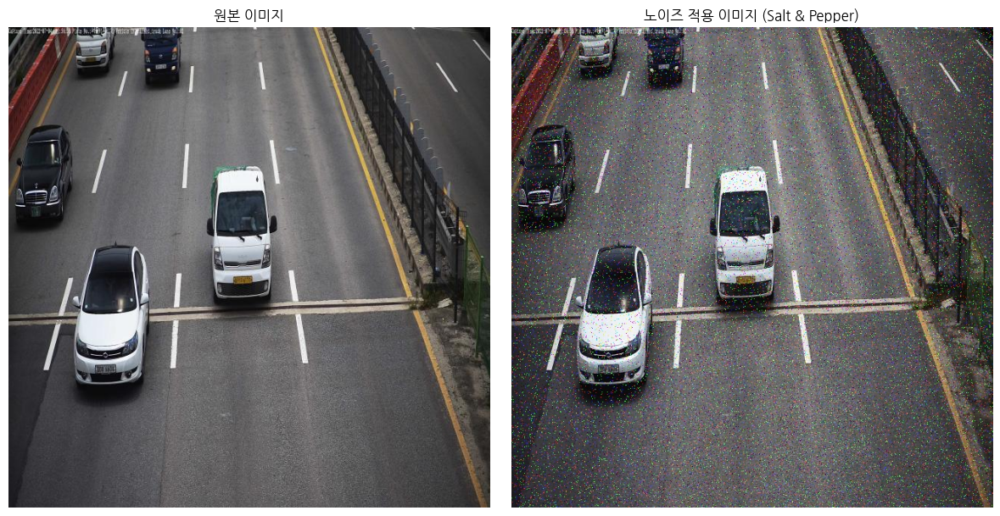

선택된 이미지: test/Car_And_Plate_2023_01_18_015483_jpg.rf.f0fd4a057a6ae270e3993db9ea0a0a7a.jpg


In [22]:
# 원본과 노이즈 적용 이미지 비교 시각화 (랜덤 샘플)
split = random.choice(splits)  # 랜덤하게 split 선택 (train/val/test)
sample_img_file = random.choice(os.listdir(os.path.join(img_path, split)))  # 랜덤하게 이미지 선택

original = cv2.imread(os.path.join(img_path, split, sample_img_file))
original = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)

noisy = cv2.imread(os.path.join(noise_img_path, split, sample_img_file))
noisy = cv2.cvtColor(noisy, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.imshow(original)
plt.title('원본 이미지')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(noisy)
plt.title('노이즈 적용 이미지 (Salt & Pepper)')
plt.axis('off')

plt.tight_layout()
plt.show()

print(f"선택된 이미지: {split}/{sample_img_file}")

### Test Data 생성

범주 내 무작위 노이즈 주입 (0.01 =< prob =< 0.1)

In [26]:
# 새로운 데이터셋 저장 경로 설정
noise_test_path = os.path.join("../datasets", "s&p_test")
noise_test_img_path = os.path.join(noise_test_path, "images")

# 기존 디렉토리가 있다면 삭제
if os.path.exists(noise_test_path):
    shutil.rmtree(noise_test_path)

# 디렉토리 구조 생성
os.makedirs(noise_test_path)
os.makedirs(noise_test_img_path)

# splits dir 생성
for subdir in splits:
    os.makedirs(os.path.join(noise_test_img_path, subdir))

# labels 디렉토리 복사
shutil.copytree(os.path.join(data_path, 'labels'), os.path.join(noise_test_path, 'labels'))
# dataset.yaml 파일 복사
shutil.copy2(os.path.join(data_path, 'dataset.yaml'), os.path.join(noise_test_path, 'dataset.yaml'))

noise_values = {split: {} for split in splits}
# train과 val 디렉토리의 모든 이미지에 랜덤 노이즈 적용
for subdir in splits:
    src_dir = os.path.join(img_path, subdir)
    dst_dir = os.path.join(noise_test_img_path, subdir)
    
    # 진행바 표시를 위한 tqdm 사용
    for img_file in tqdm.tqdm(os.listdir(src_dir), desc=f'Processing {subdir}'):
        # 이미지 로드
        img = cv2.imread(os.path.join(src_dir, img_file))
        
        # 랜덤 노이즈 강도 설정 (0.01 ~ 0.1)
        random_prob = random.uniform(0.01, 0.1)
        noise_values[subdir][img_file] = random_prob  # 노이즈 값 저장

        # 노이즈 적용
        noisy_img = add_noise(img, 'salt_and_pepper', {'prob': random_prob})
        
        # 노이즈가 적용된 이미지 저장
        cv2.imwrite(os.path.join(dst_dir, img_file), noisy_img)

print("랜덤 노이즈가 적용된 테스트 데이터셋 생성 완료!")

Processing test: 100%|██████████| 1280/1280 [00:12<00:00, 104.37it/s]

랜덤 노이즈가 적용된 테스트 데이터셋 생성 완료!


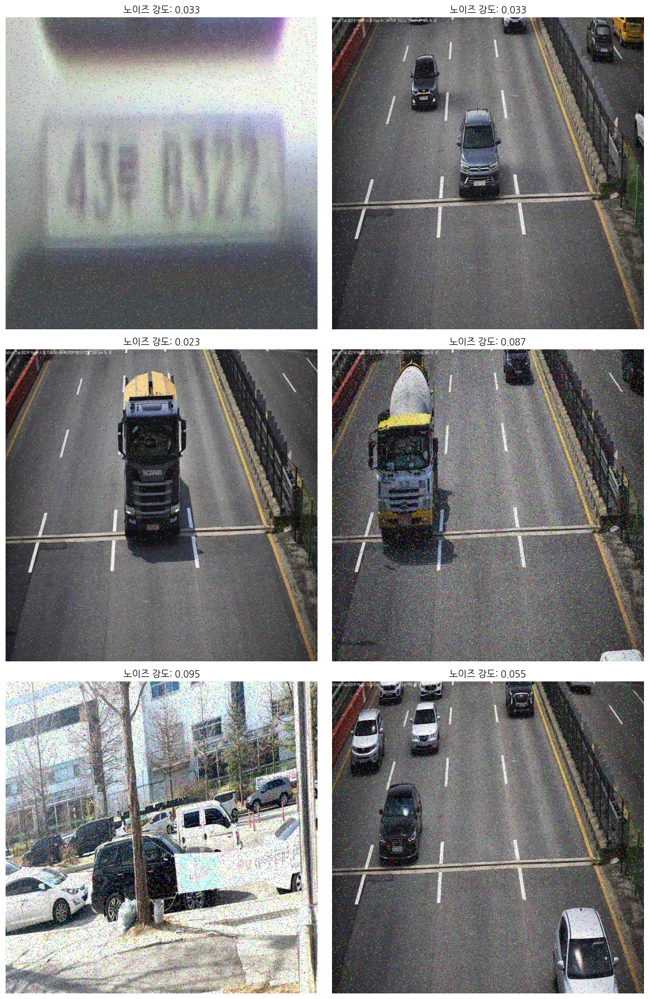

In [27]:
# 노이즈 이미지 6장 시각화
plt.figure(figsize=(12, 18))

for i in range(6):
    # 랜덤 샘플 선택
    split = random.choice(splits)
    sample_img_file = random.choice(os.listdir(os.path.join(img_path, split)))
    
    # 노이즈 적용된 이미지 로드
    noisy = cv2.imread(os.path.join(noise_test_img_path, split, sample_img_file))
    noisy = cv2.cvtColor(noisy, cv2.COLOR_BGR2RGB)
    
    # 노이즈 값 가져오기
    noise_prob = noise_values[split][sample_img_file]
    
    # 노이즈 이미지 표시
    plt.subplot(3, 2, i + 1)
    plt.imshow(noisy)
    plt.title(f'노이즈 강도: {noise_prob:.3f}')
    plt.axis('off')

plt.tight_layout()
plt.show()

## 노이즈별 데이터셋 생성

노이즈 종류 별 Current, Test Dataset 생성

### 노이즈 적용 예시

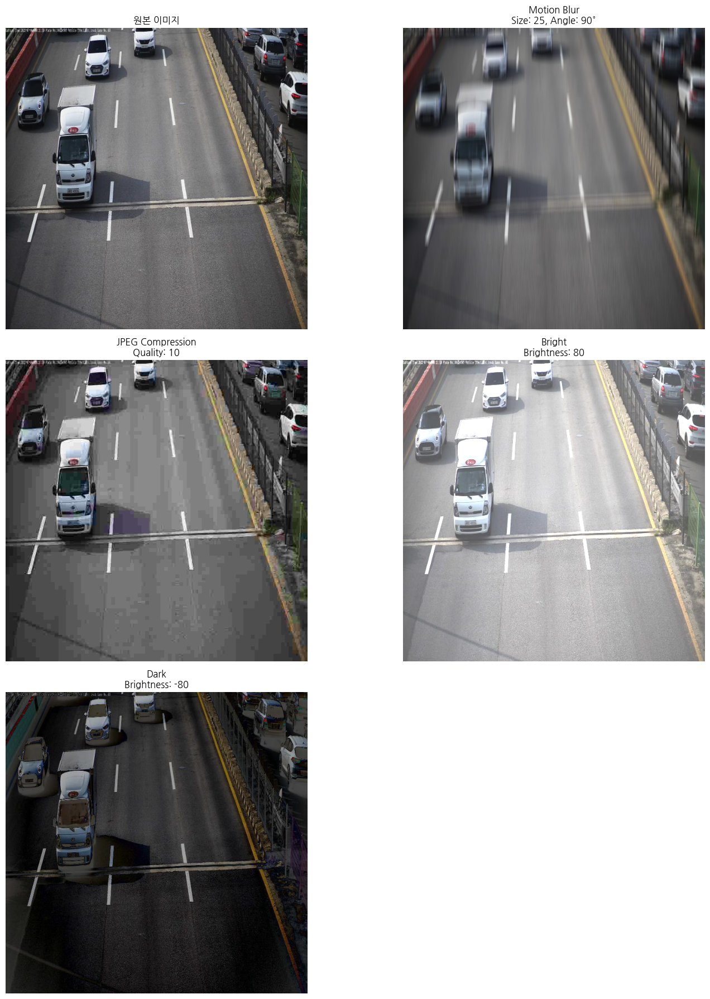

선택된 이미지 경로: ../datasets/tunelpdr_merged_all/images/train/Car_And_Plate_2023_01_18_007769_jpg.rf.4adda6089443fe28efbf12e0ae0d03fe.jpg


In [55]:
import random

img_path = os.path.join("../datasets", "tunelpdr_merged_all", "images")

# 랜덤한 이미지 선택
split = random.choice(splits)
split_path = os.path.join(img_path, split)
img_file = random.choice(os.listdir(split_path))
img_path_full = os.path.join(split_path, img_file)

# 이미지 로드
original = cv2.imread(img_path_full)
original = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)

# noise test
noise_params = {
    'motion_blur': {'size': 25, 'angle': 90},
    'jpeg_compression': {'quality': 10},
    'bright': {'brightness': 80, 'contrast': 1.0},
    'dark': {'brightness': -80, 'contrast': 1.0}
}

# 결과 시각화
plt.figure(figsize=(15, 18))

# 원본 이미지 표시
plt.subplot(3, 2, 1)
plt.imshow(original)
plt.title('원본 이미지')
plt.axis('off')

# 각 노이즈 타입 적용 결과 표시
for i, (noise_type, params) in enumerate(noise_params.items(), start=2):
    # 노이즈 적용
    if noise_type in ['bright', 'dark']:
        noisy = add_noise(original, 'brightness_contrast', params)
    else:
        noisy = add_noise(original, noise_type, params)
    
    plt.subplot(3, 2, i)
    plt.imshow(noisy)
    
    # 노이즈 파라미터 표시
    if noise_type == 'motion_blur':
        plt.title(f'Motion Blur\nSize: {params["size"]}, Angle: {params["angle"]}°')
    elif noise_type == 'jpeg_compression':
        plt.title(f'JPEG Compression\nQuality: {params["quality"]}')
    else:  # bright/dark
        plt.title(f'{noise_type.capitalize()}\nBrightness: {params["brightness"]}')
    
    plt.axis('off')

plt.tight_layout()
plt.show()

print(f"선택된 이미지 경로: {img_path_full}")

### 노이즈 데이터셋 생성

노이즈 적용을 위한 파라미터 설정

In [56]:
# 노이즈 타입별 파라미터 설정
noise_configs = {
    'motion_blur': {
        'fixed': {'size': 15, 'angle': 45},  # 중앙값
        'random': {
            'size': (5, 25),    # 모션 블러 커널 크기 범위
            'angle': (0, 90)    # 모션 블러 각도 범위
        }
    },
    'jpeg_compression': {
        'fixed': {'quality': 40},  # 중앙값
        'random': {'quality': (10, 70)}  # JPEG 품질 범위
    },
    'brightness_contrast': {
        'bright': {
            'fixed': {'brightness': 55, 'contrast': 1.0},  # 중앙값
            'random': {
                'brightness': (30, 80),  # 밝기 증가 범위
                'contrast': (1.0, 1.0)   # 대비 고정
            }
        },
        'dark': {
            'fixed': {'brightness': -55, 'contrast': 1.0},  # 중앙값
            'random': {
                'brightness': (-80, -30),  # 밝기 감소 범위
                'contrast': (1.0, 1.0)     # 대비 고정
            }
        }
    }
}

데이터셋 생성 및 시각화 기능 구현

In [57]:
import shutil
import tqdm
import json

def create_noise_dataset(noise_type, mode='current', params=None):
    """
    노이즈가 적용된 데이터셋 생성 함수
    
    Args:
        noise_type: 노이즈 종류 ('motion_blur', 'jpeg_compression', 'bright', 'dark')
        mode: 'current' 또는 'test'
        params: 노이즈 파라미터 설정
    """
    # 데이터셋 경로 설정
    dataset_name = f"{noise_type}_{mode}"
    noise_data_path = os.path.join("../datasets", dataset_name)
    noise_img_path = os.path.join(noise_data_path, "images")
    
    # 기존 디렉토리 삭제 및 새로 생성
    if os.path.exists(noise_data_path):
        shutil.rmtree(noise_data_path)
    
    os.makedirs(noise_data_path)
    os.makedirs(noise_img_path)
    
    # splits 디렉토리 생성
    for subdir in splits:
        os.makedirs(os.path.join(noise_img_path, subdir))
    
    # labels 디렉토리와 dataset.yaml 복사
    shutil.copytree(os.path.join(data_path, 'labels'), os.path.join(noise_data_path, 'labels'))
    shutil.copy2(os.path.join(data_path, 'dataset.yaml'), os.path.join(noise_data_path, 'dataset.yaml'))
    
    # 노이즈 값 저장용 딕셔너리
    noise_values = {split: {} for split in splits}
    
    # 이미지 처리
    for subdir in splits:
        src_dir = os.path.join(img_path, subdir)
        dst_dir = os.path.join(noise_img_path, subdir)
        
        for img_file in tqdm.tqdm(os.listdir(src_dir), desc=f'Processing {subdir}'):
            img = cv2.imread(os.path.join(src_dir, img_file))
            
            # 랜덤 또는 고정 파라미터 설정
            if mode == 'test':
                if noise_type == 'motion_blur':
                    size = random.randint(*params['random']['size'])
                    angle = random.uniform(*params['random']['angle'])
                    noise_params = {'size': size, 'angle': angle}
                elif noise_type == 'jpeg_compression':
                    quality = random.randint(*params['random']['quality'])
                    noise_params = {'quality': quality}
                else:  # bright/dark
                    brightness = random.uniform(*params['random']['brightness'])
                    contrast = params['random']['contrast'][0]
                    noise_params = {'brightness': brightness, 'contrast': contrast}
            else:
                noise_params = params['fixed']
            
            # 노이즈 적용
            if noise_type in ['bright', 'dark']:
                noisy_img = add_noise(img, 'brightness_contrast', noise_params)
            else:
                noisy_img = add_noise(img, noise_type, noise_params)
            
            # 이미지 저장
            cv2.imwrite(os.path.join(dst_dir, img_file), noisy_img)
            
            # 노이즈 값 저장
            noise_values[subdir][img_file] = noise_params
    
    # 노이즈 값 저장
    with open(os.path.join(noise_data_path, 'noise_values.json'), 'w') as f:
        json.dump(noise_values, f)
    
    print(f"{dataset_name} 데이터셋 생성 완료!")
    print()
    return noise_values

# 결과 시각화 함수
def visualize_noise_samples(noise_type, mode='test', num_samples=6):
    dataset_path = os.path.join("../datasets", f"{noise_type}_{mode}", "images")
    with open(os.path.join("../datasets", f"{noise_type}_{mode}", "noise_values.json"), 'r') as f:
        noise_values = json.load(f)
    
    plt.figure(figsize=(12, 18))
    
    for i in range(num_samples):
        split = random.choice(splits)
        sample_img_file = random.choice(os.listdir(os.path.join(dataset_path, split)))
        
        noisy = cv2.imread(os.path.join(dataset_path, split, sample_img_file))
        noisy = cv2.cvtColor(noisy, cv2.COLOR_BGR2RGB)
        
        noise_params = noise_values[split][sample_img_file]
        
        plt.subplot(3, 2, i + 1)
        plt.imshow(noisy)
        
        if noise_type in ['bright', 'dark']:
            plt.title(f'Brightness: {noise_params["brightness"]:.1f}')
        elif noise_type == 'motion_blur':
            plt.title(f'Size: {noise_params["size"]}, Angle: {noise_params["angle"]:.1f}°')
        else:  # jpeg_compression
            plt.title(f'Quality: {noise_params["quality"]}')
        
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

노이즈별 데이터셋 생성

In [58]:
# 원본 데이터셋 경로
data_path = "../datasets/tunelpdr_merged_all"
img_path = os.path.join(data_path, "images")
splits = os.listdir(img_path)

for noise_type, config in noise_configs.items():
    if noise_type == 'brightness_contrast':
        # bright 데이터셋
        bright_config = {
            'fixed': config['bright']['fixed'],
            'random': config['bright']['random']
        }
        create_noise_dataset('bright', 'current', bright_config)
        create_noise_dataset('bright', 'test', bright_config)
        
        # dark 데이터셋
        dark_config = {
            'fixed': config['dark']['fixed'],
            'random': config['dark']['random']
        }
        create_noise_dataset('dark', 'current', dark_config)
        create_noise_dataset('dark', 'test', dark_config)
    else:
        create_noise_dataset(noise_type, 'current', config)
        create_noise_dataset(noise_type, 'test', config)

Processing test: 100%|██████████| 1280/1280 [00:11<00:00, 112.99it/s]


motion_blur_current 데이터셋 생성 완료!



Processing test: 100%|██████████| 1280/1280 [00:10<00:00, 120.00it/s]


motion_blur_test 데이터셋 생성 완료!



Processing test: 100%|██████████| 1280/1280 [00:04<00:00, 270.45it/s]


jpeg_compression_current 데이터셋 생성 완료!



Processing test: 100%|██████████| 1280/1280 [00:04<00:00, 257.57it/s]


jpeg_compression_test 데이터셋 생성 완료!



Processing test: 100%|██████████| 1280/1280 [00:03<00:00, 394.25it/s]


bright_current 데이터셋 생성 완료!



Processing test: 100%|██████████| 1280/1280 [00:03<00:00, 393.59it/s]


bright_test 데이터셋 생성 완료!



Processing test: 100%|██████████| 1280/1280 [00:03<00:00, 387.65it/s]


dark_current 데이터셋 생성 완료!



Processing test: 100%|██████████| 1280/1280 [00:03<00:00, 388.15it/s]

dark_test 데이터셋 생성 완료!



생성된 데이터셋 시각화를 통한 검증


motion_blur 테스트 데이터셋 샘플:


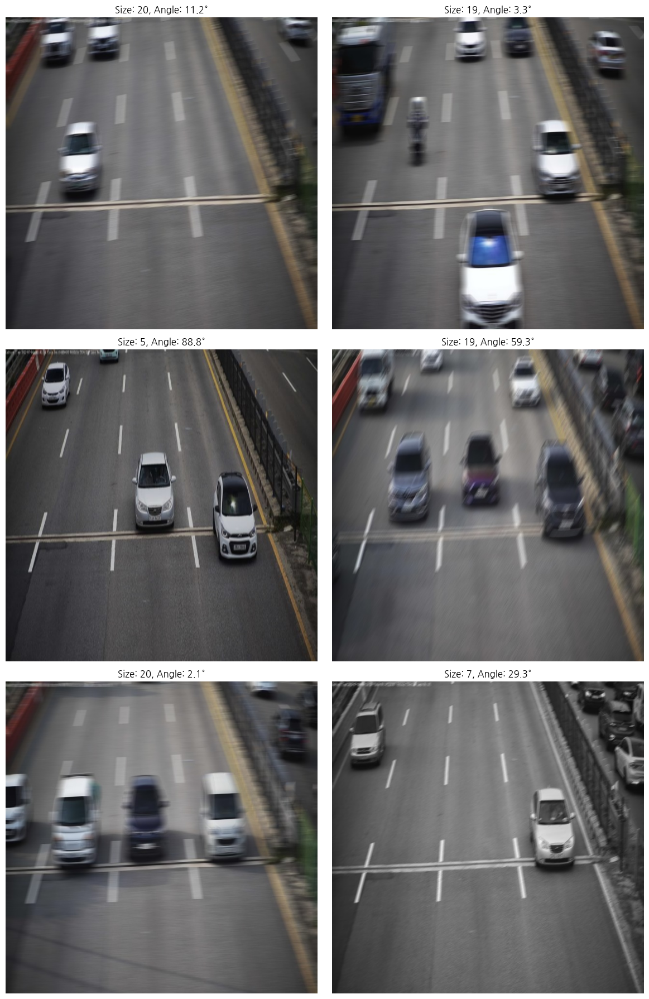


jpeg_compression 테스트 데이터셋 샘플:


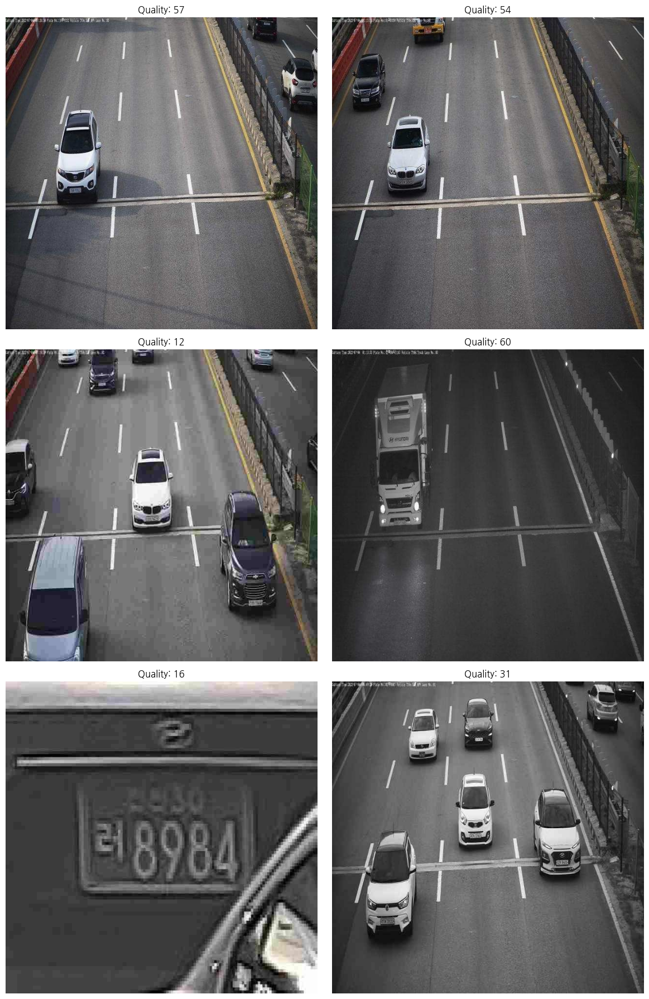


bright 테스트 데이터셋 샘플:


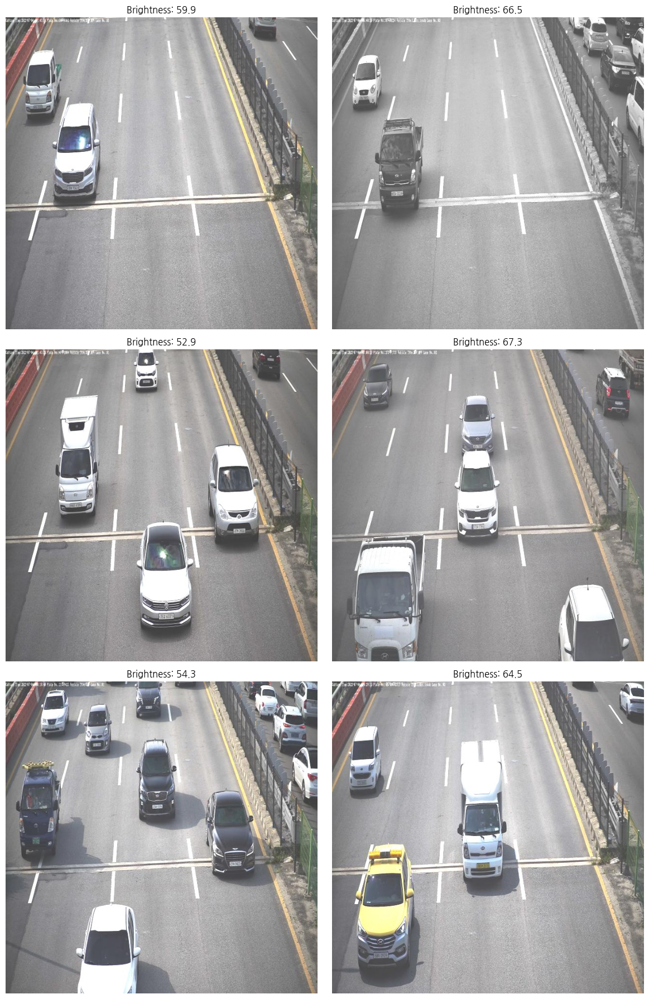


dark 테스트 데이터셋 샘플:


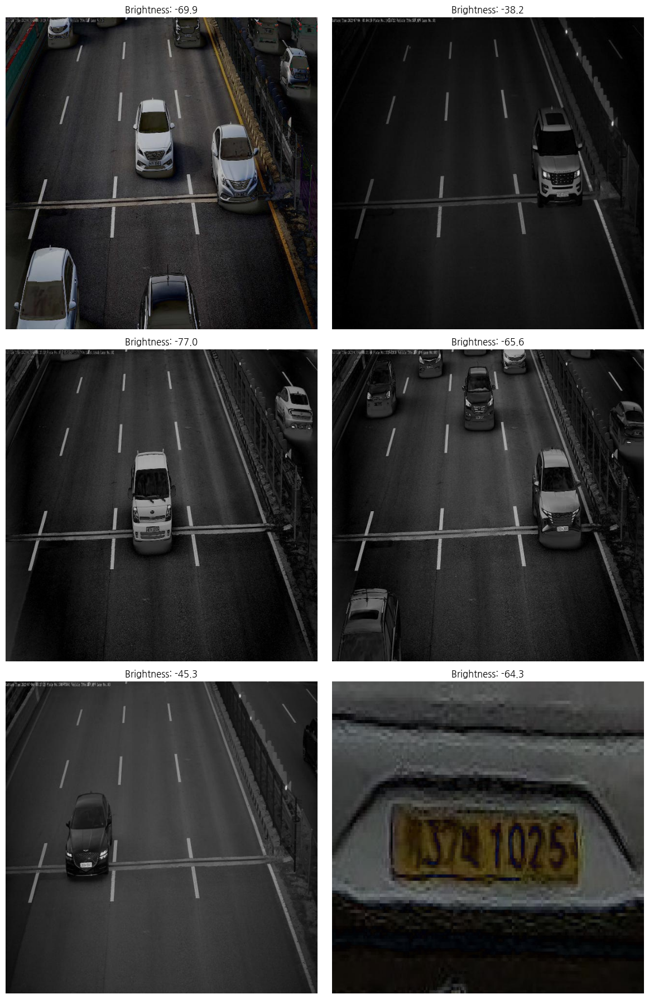

In [59]:
for noise_type in ['motion_blur', 'jpeg_compression', 'bright', 'dark']:
    print(f"\n{noise_type} 테스트 데이터셋 샘플:")
    visualize_noise_samples(noise_type, 'test')

무작위 노이즈 적용 데이터셋에서 최대강도 적용 샘플 관측

In [62]:
import json
from matplotlib import pyplot as plt
import os

def find_max_noise_samples(noise_type):
    """최대 노이즈가 적용된 샘플을 찾는 함수"""
    dataset_path = os.path.join("../datasets", f"{noise_type}_test", "images")
    with open(os.path.join("../datasets", f"{noise_type}_test", "noise_values.json"), 'r') as f:
        noise_values = json.load(f)
    
    max_value = float('-inf')
    max_sample = None
    max_split = None
    
    for split in splits:
        for img_file, params in noise_values[split].items():
            # 노이즈 타입별로 최대값 기준 설정
            if noise_type == 'motion_blur':
                current_value = params['size']  # 커널 사이즈 기준
            elif noise_type == 'jpeg_compression':
                current_value = -params['quality']  # 품질이 낮을수록 노이즈가 큼
            elif noise_type == 'bright':
                current_value = params['brightness']
            else:  # dark
                current_value = -params['brightness']  # 더 어두울수록 값이 작음
                
            if current_value > max_value:
                max_value = current_value
                max_sample = img_file
                max_split = split
    
    return max_split, max_sample, noise_values[max_split][max_sample]

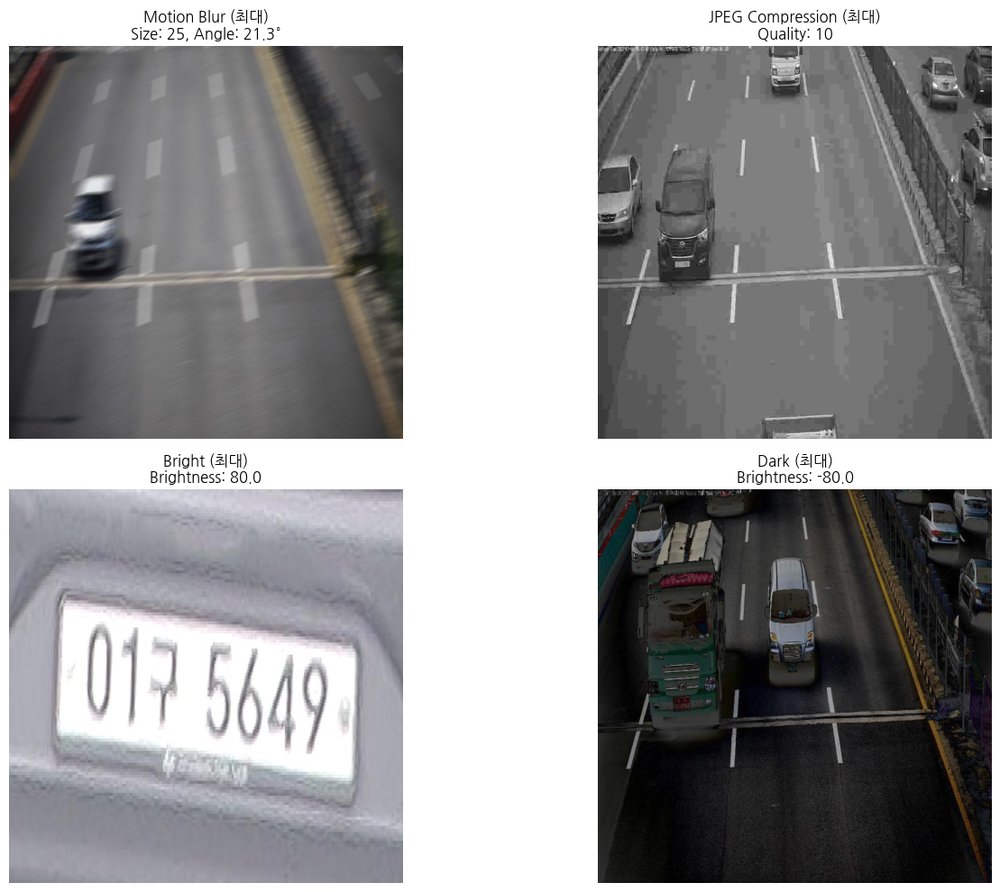

In [63]:
import cv2

# 최대 노이즈 샘플 시각화
plt.rc('font', family='NanumGothic')
plt.figure(figsize=(15, 10))
noise_types = ['motion_blur', 'jpeg_compression', 'bright', 'dark']
splits = ['train', 'val', 'test']

for i, noise_type in enumerate(noise_types):
    # 최대 노이즈 샘플 찾기
    max_split, max_sample, max_params = find_max_noise_samples(noise_type)
    
    # 이미지 로드
    img_path = os.path.join("../datasets", f"{noise_type}_test", "images", max_split, max_sample)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # 시각화
    plt.subplot(2, 2, i + 1)
    plt.imshow(img)
    
    # 노이즈 파라미터 표시
    if noise_type == 'motion_blur':
        plt.title(f'Motion Blur (최대)\nSize: {max_params["size"]}, Angle: {max_params["angle"]:.1f}°')
    elif noise_type == 'jpeg_compression':
        plt.title(f'JPEG Compression (최대)\nQuality: {max_params["quality"]}')
    else:  # bright/dark
        plt.title(f'{noise_type.capitalize()} (최대)\nBrightness: {max_params["brightness"]:.1f}')
    
    plt.axis('off')

plt.tight_layout()
plt.show()

## 드리프트 분석

노이즈별 데이터셋의 드리프트 현상 시각화

In [8]:
import fiftyone as fo
import torch
import clip
import fiftyone.brain as fob
from PIL import Image
from sklearn.decomposition import PCA
from scipy.stats import gaussian_kde
import numpy as np
import pandas as pd
import os

fo.list_datasets()

['snp_current', 'snp_merged', 'snp_test', 'tunelpdr_merged_all']

In [6]:
splits = ['train', 'val', 'test']
ref_dataset = fo.Dataset("tunelpdr_merged_all")

for split in splits:
    ref_dataset.add_dir(
        dataset_dir=os.path.join("../datasets", "tunelpdr_merged_all"),
        dataset_type=fo.types.YOLOv5Dataset,
        split=split,
        tags=split,
    )

for sample in ref_dataset:
    sample['source'] = "ref"
    sample.save()

 100% |███████████████| 8954/8954 [13.1s elapsed, 0s remaining, 777.0 samples/s]      
 100% |███████████████| 2558/2558 [3.7s elapsed, 0s remaining, 702.8 samples/s]      
 100% |███████████████| 1280/1280 [1.8s elapsed, 0s remaining, 692.3 samples/s]      


In [7]:
ref_dataset

Name:        tunelpdr_merged_all
Media type:  image
Num samples: 12792
Persistent:  False
Tags:        []
Sample fields:
    id:               fiftyone.core.fields.ObjectIdField
    filepath:         fiftyone.core.fields.StringField
    tags:             fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:         fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.ImageMetadata)
    created_at:       fiftyone.core.fields.DateTimeField
    last_modified_at: fiftyone.core.fields.DateTimeField
    ground_truth:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    source:           fiftyone.core.fields.StringField

In [12]:
def get_51_dataset(name, path, source):
    dataset = fo.Dataset(name)
    splits = ['train', 'val', 'test']

    for split in splits:
        dataset.add_dir(
            dataset_dir=path,
            dataset_type=fo.types.YOLOv5Dataset,
            split=split,
            tags=split,
        )

    for sample in dataset:
        sample['source'] = source
        sample.save()

    return dataset

def get_embeddings(dataset, device, model, preprocess):

    for sample in tqdm.tqdm(dataset, desc=f"{dataset.name} 임베딩 계산 중"):
        with torch.no_grad():
            inputs = preprocess(Image.open(sample.filepath)).unsqueeze(0).to(device)
            embedding = model.encode_image(inputs).cpu().numpy().flatten()
            sample['clip_embeddings'] = embedding.tolist()
            sample.save()
    
def collect_image_embeddings_by_sample_id(dataset):

    print(f"Collecting image embeddings by sample ID for {dataset.name}")
    image_embeddings = {}
    for sample in dataset:
        sample_id = sample.id
        if 'clip_embeddings' in sample:
            # 샘플 ID를 키로, 이미지 임베딩을 값으로 저장
            image_embeddings[sample_id] = np.array(sample['clip_embeddings'])

    return image_embeddings

### Salt & Pepper 데이터 드리프트 분석

In [9]:
snp_cur_dataset = get_51_dataset("snp_current", "../datasets/s&p_cur", "current")
snp_test_dataset = get_51_dataset("snp_test", "../datasets/s&p_test", "test")

 100% |███████████████| 8954/8954 [12.8s elapsed, 0s remaining, 835.4 samples/s]      
 100% |███████████████| 2558/2558 [4.6s elapsed, 0s remaining, 669.2 samples/s]      
 100% |███████████████| 1280/1280 [1.9s elapsed, 0s remaining, 678.3 samples/s]         
 100% |███████████████| 8954/8954 [12.7s elapsed, 0s remaining, 779.6 samples/s]      
 100% |███████████████| 2558/2558 [3.8s elapsed, 0s remaining, 711.8 samples/s]      
 100% |███████████████| 1280/1280 [1.8s elapsed, 0s remaining, 693.8 samples/s]      


In [10]:
snp_merged_dataset = fo.Dataset("snp_merged")
snp_merged_dataset.add_samples(ref_dataset)
snp_merged_dataset.add_samples(snp_cur_dataset)
snp_merged_dataset.add_samples(snp_test_dataset)

 100% |█████████████| 12792/12792 [23.5s elapsed, 0s remaining, 513.4 samples/s]      
 100% |█████████████| 12792/12792 [23.4s elapsed, 0s remaining, 556.4 samples/s]      
 100% |█████████████| 12792/12792 [23.8s elapsed, 0s remaining, 505.3 samples/s]      


['67bc2e1af85e6ac853d4fc1a',
 '67bc2e1af85e6ac853d4fc27',
 '67bc2e1af85e6ac853d4fc28',
 '67bc2e1af85e6ac853d4fc29',
 '67bc2e1af85e6ac853d4fc2a',
 '67bc2e1af85e6ac853d4fc2b',
 '67bc2e1af85e6ac853d4fc2c',
 '67bc2e1af85e6ac853d4fc2d',
 '67bc2e1af85e6ac853d4fc2e',
 '67bc2e1af85e6ac853d4fc84',
 '67bc2e1af85e6ac853d4fc85',
 '67bc2e1af85e6ac853d4fc86',
 '67bc2e1af85e6ac853d4fc87',
 '67bc2e1af85e6ac853d4fc88',
 '67bc2e1af85e6ac853d4fc89',
 '67bc2e1af85e6ac853d4fc8a',
 '67bc2e1af85e6ac853d4fc8b',
 '67bc2e1af85e6ac853d4fc8c',
 '67bc2e1af85e6ac853d4fc8d',
 '67bc2e1af85e6ac853d4fc8e',
 '67bc2e1af85e6ac853d4fc8f',
 '67bc2e1af85e6ac853d4fc90',
 '67bc2e1af85e6ac853d4fc91',
 '67bc2e1af85e6ac853d4fc92',
 '67bc2e1af85e6ac853d4fc93',
 '67bc2e1af85e6ac853d4fc94',
 '67bc2e1af85e6ac853d4fc95',
 '67bc2e1af85e6ac853d4fc96',
 '67bc2e1af85e6ac853d4fc97',
 '67bc2e1af85e6ac853d4fc98',
 '67bc2e1af85e6ac853d4fc99',
 '67bc2e1af85e6ac853d4fc9a',
 '67bc2e1af85e6ac853d4fc9b',
 '67bc2e1af85e6ac853d4fc9c',
 '67bc2e1af85e

In [ ]:
import tqdm

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model, preprocess = clip.load("ViT-B/16", device=device)

get_embeddings(snp_merged_dataset, device, model, preprocess)

In [13]:
embeddings_by_sample_id = collect_image_embeddings_by_sample_id(snp_merged_dataset)

results = fob.compute_visualization(
    snp_merged_dataset,
    embeddings=embeddings_by_sample_id,
    brain_key="clip_embeddings",
    plot_points=True,
    verbose=True,
)

Generating visualization...


/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


UMAP( verbose=True)
Mon Feb 24 17:56:02 2025 Construct fuzzy simplicial set
Mon Feb 24 17:56:02 2025 Finding Nearest Neighbors
Mon Feb 24 17:56:02 2025 Building RP forest with 15 trees
Mon Feb 24 17:56:07 2025 NN descent for 15 iterations
	 1  /  15
	 2  /  15
	 3  /  15
	 4  /  15
	Stopping threshold met -- exiting after 4 iterations
Mon Feb 24 17:56:17 2025 Finished Nearest Neighbor Search
Mon Feb 24 17:56:19 2025 Construct embedding


Epochs completed:   5%| ▌          10/200 [00:01]

	completed  0  /  200 epochs


Epochs completed:  16%| █▋         33/200 [00:01]

	completed  20  /  200 epochs


Epochs completed:  24%| ██▍        49/200 [00:01]

	completed  40  /  200 epochs


Epochs completed:  36%| ███▌       72/200 [00:02]

	completed  60  /  200 epochs


Epochs completed:  48%| ████▊      95/200 [00:02]

	completed  80  /  200 epochs


Epochs completed:  56%| █████▌     111/200 [00:02]

	completed  100  /  200 epochs


Epochs completed:  66%| ██████▋    133/200 [00:03]

	completed  120  /  200 epochs


Epochs completed:  74%| ███████▍   148/200 [00:03]

	completed  140  /  200 epochs


Epochs completed:  86%| ████████▌  172/200 [00:03]

	completed  160  /  200 epochs


Epochs completed:  98%| █████████▊ 196/200 [00:04]

	completed  180  /  200 epochs


Epochs completed: 100%| ██████████ 200/200 [00:04]


Mon Feb 24 17:56:36 2025 Finished embedding


In [95]:
session = fo.launch_app(snp_merged_dataset)

In [1]:
def calculate_mmd_batch(X, Y, batch_size=1000, gamma=None):
    """
    배치 처리를 통한 MMD 계산
    """
    # 배치 크기 조정
    batch_size = min(batch_size, min(len(X), len(Y)))
    
    # 랜덤 샘플링
    if len(X) > batch_size:
        idx = np.random.choice(len(X), batch_size, replace=False)
        X = X[idx]
    if len(Y) > batch_size:
        idx = np.random.choice(len(Y), batch_size, replace=False)
        Y = Y[idx]
    
    if gamma is None:
        # 중간값 휴리스틱 사용 (배치 데이터 기준)
        X_combined = np.vstack([X[:batch_size], Y[:batch_size]])
        pairwise_dists = np.sum((X_combined[:, np.newaxis] - X_combined) ** 2, axis=2)
        gamma = 1.0 / np.median(pairwise_dists[pairwise_dists > 0])

    def kernel(X, Y):
        # RBF 커널
        X_norm = np.sum(X ** 2, axis=1)
        Y_norm = np.sum(Y ** 2, axis=1)
        distances = X_norm[:, np.newaxis] + Y_norm - 2 * np.dot(X, Y.T)
        return np.exp(-gamma * distances)

    K_XX = kernel(X, X)
    K_YY = kernel(Y, Y)
    K_XY = kernel(X, Y)

    n_X = X.shape[0]
    n_Y = Y.shape[0]

    mmd = (np.sum(K_XX) - np.trace(K_XX)) / (n_X * (n_X - 1))
    mmd += (np.sum(K_YY) - np.trace(K_YY)) / (n_Y * (n_Y - 1))
    mmd -= 2 * np.mean(K_XY)

    return np.sqrt(max(mmd, 0))

def visualize_fixed_projection_drift(ref_data, cur_data, test_data, title="임베딩 드리프트 비교"):
    """
    고정된 프로젝션으로 드리프트 시각화
    """
    # 1. MMD 점수 계산
    ref_mmd = calculate_mmd_batch(test_data, ref_data, batch_size=1000)
    cur_mmd = calculate_mmd_batch(test_data, cur_data, batch_size=1000)
    
    # 2. PCA 및 시각화
    pca = PCA(n_components=2)
    pca.fit(test_data)
    
    test_transformed = pca.transform(test_data)
    ref_transformed = pca.transform(ref_data)
    cur_transformed = pca.transform(cur_data)
    
    all_transformed = np.vstack([test_transformed, ref_transformed, cur_transformed])
    x_min, x_max = all_transformed[:, 0].min(), all_transformed[:, 0].max()
    y_min, y_max = all_transformed[:, 1].min(), all_transformed[:, 1].max()
    xx, yy = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
    positions = np.vstack([xx.ravel(), yy.ravel()])
    
    def calculate_density(data):
        kde = gaussian_kde(data.T)
        z = kde(positions).reshape(xx.shape)
        return z
    
    test_density = calculate_density(test_transformed)
    ref_density = calculate_density(ref_transformed)
    cur_density = calculate_density(cur_transformed)
    
    # 3. 시각화
    fig = plt.figure(figsize=(15, 6))  # 높이 약간 증가
    
    # 서브플롯 그리드 설정 (상단: 등고선, 하단: MMD 점수)
    gs = plt.GridSpec(2, 3, height_ratios=[4, 1])
    
    # 등고선 그래프
    cmaps = ['Purples', 'Blues', 'Reds']
    titles = ['Test 데이터', 'Reference 데이터\nMMD: {:.4f}'.format(ref_mmd), 
             'Current 데이터\nMMD: {:.4f}'.format(cur_mmd)]
    densities = [test_density, ref_density, cur_density]
    transformed_data = [test_transformed, ref_transformed, cur_transformed]
    
    for idx, (density, data, cmap, subtitle) in enumerate(zip(densities, transformed_data, 
                                                            cmaps, titles)):
        ax = plt.subplot(gs[0, idx])
        contour = ax.contourf(xx, yy, density, levels=20, cmap=cmap)
        ax.scatter(data[:, 0], data[:, 1], c='black', alpha=0.1, s=1)
        plt.colorbar(contour, ax=ax, label='밀도')
        ax.set_title(subtitle)
    
    # MMD 점수 바 그래프
    ax_mmd = plt.subplot(gs[1, :])
    bars = ax_mmd.bar(['Reference vs Test', 'Current vs Test'], 
                     [ref_mmd, cur_mmd],
                     color=['blue', 'red'], alpha=0.6)
    ax_mmd.set_title('MMD 점수 비교')
    ax_mmd.set_ylabel('MMD Score')
    
    # 바 위에 값 표시
    for bar in bars:
        height = bar.get_height()
        ax_mmd.text(bar.get_x() + bar.get_width()/2., height,
                   f'{height:.4f}',
                   ha='center', va='bottom')
    
    # 전체 제목
    plt.suptitle(f'{title}\nPC1 설명력: {pca.explained_variance_ratio_[0]:.3f}, '
                f'PC2 설명력: {pca.explained_variance_ratio_[1]:.3f}')
    plt.tight_layout()
    
    return fig

In [3]:
import fiftyone as fo

fo.list_datasets()

['snp_current', 'snp_merged', 'snp_test', 'tunelpdr_merged_all']

In [4]:
snp_merged_dataset = fo.load_dataset("snp_merged")

/tmp/ipykernel_1168/2906345688.py:112: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  plt.tight_layout()
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  fig.canvas.print_figure(bytes_io, **kw)


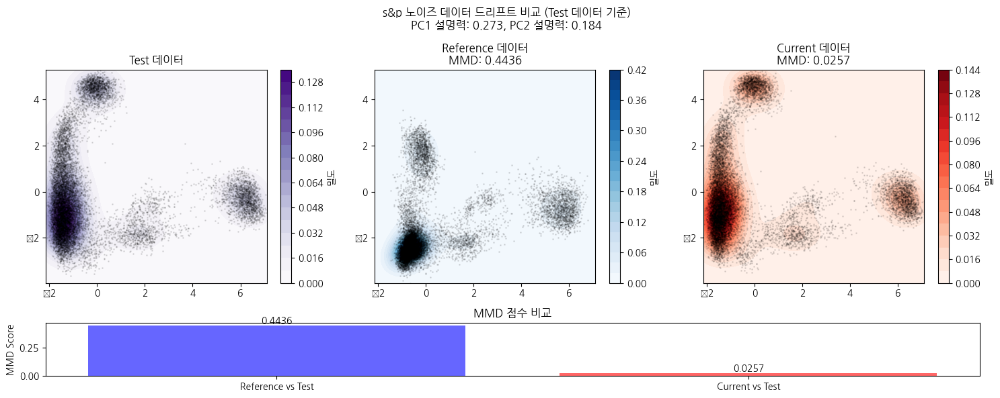

In [11]:
from matplotlib import pyplot as plt
import pandas as pd
import numpy as np

# 소스별 데이터 분리
source_groups = {}
for sample in snp_merged_dataset:
    source = sample.source
    if source not in source_groups:
        source_groups[source] = []
    source_groups[source].append(sample['clip_embeddings'])

# 소스별 데이터프레임 생성
dfs = {}
for source, embeddings in source_groups.items():
    dfs[source] = pd.DataFrame(embeddings)

plt.rc('font', family='NanumGothic')
fig = visualize_fixed_projection_drift(
    dfs['ref'].values, dfs['current'].values, dfs['test'].values,
    "s&p 노이즈 데이터 드리프트 비교 (Test 데이터 기준)"
)
plt.show()

In [14]:
ref_dataset = fo.load_dataset("tunelpdr_merged_all")

In [23]:
for d in fo.list_datasets():
    if 'motion_blur' in d:
        print(d)
        fo.delete_dataset(d)

fo.list_datasets()

motion_blur_current
motion_blur_merged
motion_blur_test


['snp_current', 'snp_merged', 'snp_test', 'tunelpdr_merged_all']


motion_blur 노이즈 데이터 드리프트 분석 중...
 100% |███████████████| 8954/8954 [12.2s elapsed, 0s remaining, 861.8 samples/s]      
 100% |███████████████| 2558/2558 [3.7s elapsed, 0s remaining, 703.0 samples/s]      
 100% |███████████████| 1280/1280 [1.6s elapsed, 0s remaining, 812.9 samples/s]         
 100% |███████████████| 8954/8954 [12.3s elapsed, 0s remaining, 838.2 samples/s]      
 100% |███████████████| 2558/2558 [3.7s elapsed, 0s remaining, 695.2 samples/s]      
 100% |███████████████| 1280/1280 [1.6s elapsed, 0s remaining, 808.1 samples/s]         
 100% |█████████████| 12792/12792 [22.3s elapsed, 0s remaining, 612.7 samples/s]      
 100% |█████████████| 12792/12792 [22.5s elapsed, 0s remaining, 521.5 samples/s]      
 100% |█████████████| 12792/12792 [22.3s elapsed, 0s remaining, 553.9 samples/s]      


motion_blur_merged 임베딩 계산 중: 100%|██████████| 38376/38376 [10:33<00:00, 60.61it/s]
/tmp/ipykernel_1168/2906345688.py:112: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  plt.tight_layout()
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  fig.canvas.print_figure(bytes_io, **kw)


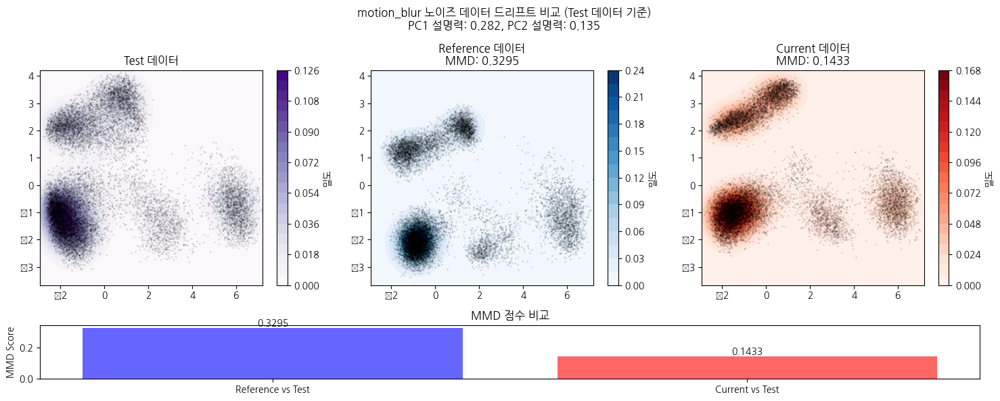


jpeg_compression 노이즈 데이터 드리프트 분석 중...
 100% |███████████████| 8954/8954 [12.3s elapsed, 0s remaining, 787.9 samples/s]      
 100% |███████████████| 2558/2558 [3.9s elapsed, 0s remaining, 673.2 samples/s]      
 100% |███████████████| 1280/1280 [2.0s elapsed, 0s remaining, 637.2 samples/s]      
 100% |███████████████| 8954/8954 [12.3s elapsed, 0s remaining, 756.6 samples/s]      
 100% |███████████████| 2558/2558 [3.9s elapsed, 0s remaining, 647.3 samples/s]      
 100% |███████████████| 1280/1280 [2.8s elapsed, 0s remaining, 435.4 samples/s]      
 100% |█████████████| 12792/12792 [21.9s elapsed, 0s remaining, 572.3 samples/s]      
 100% |█████████████| 12792/12792 [21.8s elapsed, 0s remaining, 541.3 samples/s]      
 100% |█████████████| 12792/12792 [22.0s elapsed, 0s remaining, 574.8 samples/s]      


jpeg_compression_merged 임베딩 계산 중: 100%|██████████| 38376/38376 [10:12<00:00, 62.66it/s]
/tmp/ipykernel_1168/2906345688.py:112: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  plt.tight_layout()
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  fig.canvas.print_figure(bytes_io, **kw)


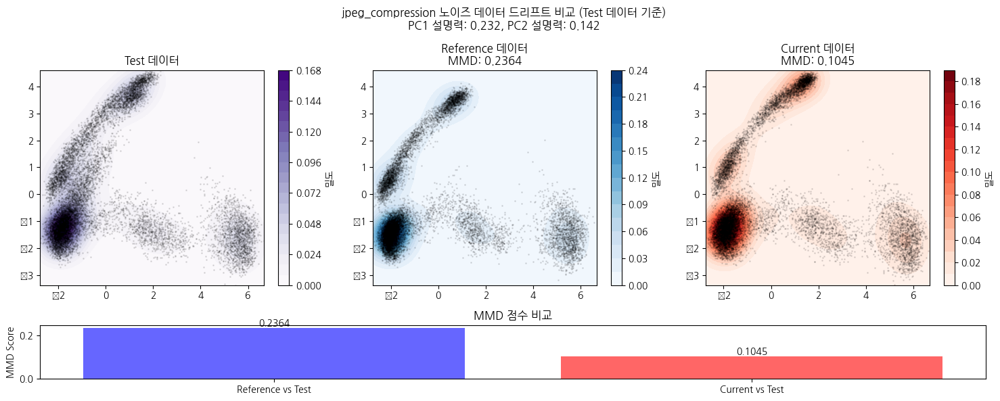


bright 노이즈 데이터 드리프트 분석 중...
 100% |███████████████| 8954/8954 [12.3s elapsed, 0s remaining, 845.1 samples/s]      
 100% |███████████████| 2558/2558 [3.7s elapsed, 0s remaining, 796.4 samples/s]      
 100% |███████████████| 1280/1280 [1.9s elapsed, 0s remaining, 667.1 samples/s]      
 100% |███████████████| 8954/8954 [12.5s elapsed, 0s remaining, 879.0 samples/s]      
 100% |███████████████| 2558/2558 [3.6s elapsed, 0s remaining, 722.1 samples/s]      
 100% |███████████████| 1280/1280 [1.8s elapsed, 0s remaining, 719.7 samples/s]         
 100% |█████████████| 12792/12792 [21.7s elapsed, 0s remaining, 617.8 samples/s]      
 100% |█████████████| 12792/12792 [22.1s elapsed, 0s remaining, 576.3 samples/s]      
 100% |█████████████| 12792/12792 [21.9s elapsed, 0s remaining, 542.4 samples/s]      


bright_merged 임베딩 계산 중: 100%|██████████| 38376/38376 [10:17<00:00, 62.10it/s]
/tmp/ipykernel_1168/2906345688.py:112: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  plt.tight_layout()
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  fig.canvas.print_figure(bytes_io, **kw)


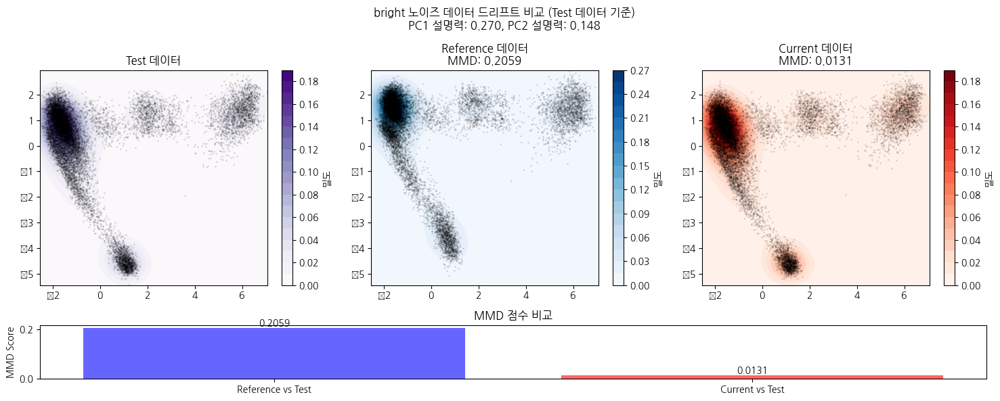


dark 노이즈 데이터 드리프트 분석 중...
 100% |███████████████| 8954/8954 [12.3s elapsed, 0s remaining, 854.9 samples/s]      
 100% |███████████████| 2558/2558 [3.7s elapsed, 0s remaining, 688.7 samples/s]      
 100% |███████████████| 1280/1280 [1.9s elapsed, 0s remaining, 688.7 samples/s]         
 100% |███████████████| 8954/8954 [11.4s elapsed, 0s remaining, 896.0 samples/s]      
 100% |███████████████| 2558/2558 [3.5s elapsed, 0s remaining, 740.0 samples/s]      
 100% |███████████████| 1280/1280 [1.7s elapsed, 0s remaining, 743.4 samples/s]         
 100% |█████████████| 12792/12792 [21.8s elapsed, 0s remaining, 578.3 samples/s]      
 100% |█████████████| 12792/12792 [21.9s elapsed, 0s remaining, 537.3 samples/s]      
 100% |█████████████| 12792/12792 [21.8s elapsed, 0s remaining, 608.4 samples/s]      


dark_merged 임베딩 계산 중: 100%|██████████| 38376/38376 [10:27<00:00, 61.18it/s]
/tmp/ipykernel_1168/2906345688.py:112: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  plt.tight_layout()
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from font(s) NanumGothic.
  fig.canvas.print_figure(bytes_io, **kw)


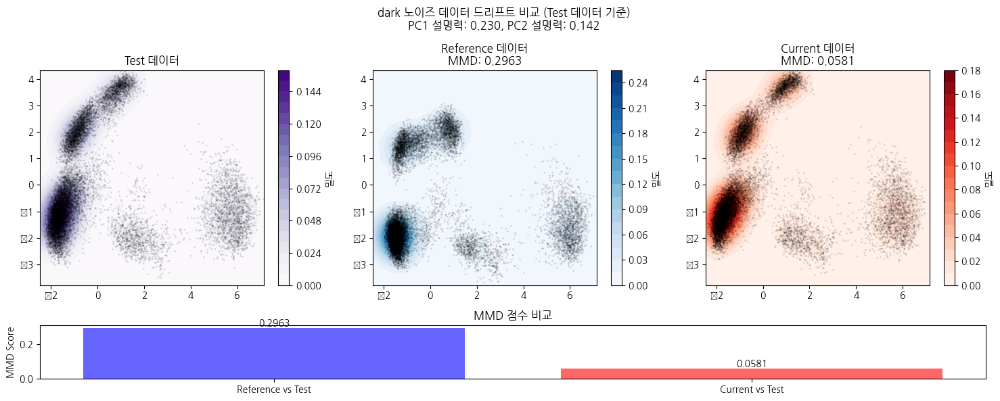

In [24]:
import tqdm

# 노이즈 타입 정의
noise_types = ['motion_blur', 'jpeg_compression', 'bright', 'dark']
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model, preprocess = clip.load("ViT-B/16", device=device)

# 각 노이즈 타입별로 처리
for noise_type in noise_types:
    print(f"\n{noise_type} 노이즈 데이터 드리프트 분석 중...")
    
    # 데이터셋 로드
    cur_dataset = get_51_dataset(
        f"{noise_type}_current",
        f"../datasets/{noise_type}_current",
        "current"
    )
    
    test_dataset = get_51_dataset(
        f"{noise_type}_test",
        f"../datasets/{noise_type}_test",
        "test"
    )
    
    # 병합 데이터셋 생성
    merged_dataset = fo.Dataset(f"{noise_type}_merged")
    merged_dataset.add_samples(ref_dataset)
    merged_dataset.add_samples(cur_dataset)
    merged_dataset.add_samples(test_dataset)
    
    # CLIP 임베딩 추출
    get_embeddings(merged_dataset, device, model, preprocess)
    
    # 소스별 데이터 분리
    source_groups = {}
    for sample in merged_dataset:
        source = sample.source
        if source not in source_groups:
            source_groups[source] = []
        source_groups[source].append(sample['clip_embeddings'])
    
    # 소스별 데이터프레임 생성
    dfs = {}
    for source, embeddings in source_groups.items():
        dfs[source] = pd.DataFrame(embeddings)
    
    # 드리프트 시각화
    plt.rc('font', family='NanumGothic')
    fig = visualize_fixed_projection_drift(
        dfs['ref'].values,
        dfs['current'].values,
        dfs['test'].values,
        f"{noise_type} 노이즈 데이터 드리프트 비교 (Test 데이터 기준)"
    )
    plt.show()

    del cur_dataset
    del test_dataset
    del merged_dataset
    del source_groups
    del dfs

In [25]:
fo.list_datasets()

['bright_current',
 'bright_merged',
 'bright_test',
 'dark_current',
 'dark_merged',
 'dark_test',
 'jpeg_compression_current',
 'jpeg_compression_merged',
 'jpeg_compression_test',
 'motion_blur_current',
 'motion_blur_merged',
 'motion_blur_test',
 'snp_current',
 'snp_merged',
 'snp_test',
 'tunelpdr_merged_all']

## 모델 학습 및 성능 분석

In [26]:
from ultralytics import YOLO

noise_types = ['snp', 'motion_blur', 'jpeg_compression', 'bright', 'dark']
base_model = "../models/yolov8n.pt"
prj_path = "logs/tlpdr_noise_variations"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

for noise_type in noise_types:
    print(f"\n{noise_type} 노이즈 데이터 학습 시작 : ")
    model = YOLO(base_model)
    model.train(
        data=f"../datasets/{noise_type}_current/dataset.yaml",
        epochs=20,
        imgsz=640,
        device=device,
        project=prj_path,
        name=f"train_{noise_type}",
        exist_ok=True,
    )
    print(f"{noise_type} 노이즈 데이터 학습 완료")
    print(f"학습 결과 저장 경로: {prj_path}/train_{noise_type}")


snp 노이즈 데이터 학습 시작 : 
New https://pypi.org/project/ultralytics/8.3.78 available 😃 Update with 'pip install -U ultralytics'
engine/trainer: task=detect, mode=train, model=../models/yolov8n.pt, data=../datasets/snp_current/dataset.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=logs/tlpdr_noise_variations, name=train_snp, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_tx

100%|██████████| 5.35M/5.35M [00:00<00:00, 20.0MB/s]
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:258: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:263: UserWarning: Deterministic behavior was enabled with eit

AMP: checks passed ✅


train: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/snp_current/labels/train... 8954 images, 12 backgrounds, 0 corrupt: 100%|██████████| 8954/8954 [00:08<00:00, 1104.11it/s]


train: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/snp_current/labels/train.cache


val: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/snp_current/labels/val... 2558 images, 1 backgrounds, 0 corrupt: 100%|██████████| 2558/2558 [00:02<00:00, 1053.66it/s]

val: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/snp_current/labels/val.cache


Plotting labels to logs/tlpdr_noise_variations/train_snp/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to logs/tlpdr_noise_variations/train_snp
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       1/20      2.55G      1.533      1.741      1.113         46        640: 100%|██████████| 560/560 [01:00<00:00,  9.32it/s]
                 Class     Images  Ins

                   all       2558       9499       0.93      0.878      0.948      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       2/20      2.54G      1.284     0.8292      1.001         55        640: 100%|██████████| 560/560 [00:57<00:00,  9.77it/s]
                 Class     Images  Ins

                   all       2558       9499      0.954      0.937      0.974      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       3/20      2.55G      1.222     0.7431     0.9851         47        640: 100%|██████████| 560/560 [00:56<00:00, 10.00it/s]
                 Class     Images  Ins

                   all       2558       9499      0.962      0.943      0.982      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       4/20      2.53G      1.153     0.6724     0.9687         28        640: 100%|██████████| 560/560 [00:56<00:00,  9.95it/s]
                 Class     Images  Ins

                   all       2558       9499      0.957      0.942      0.981      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       5/20      2.53G      1.106     0.6291     0.9513         27        640: 100%|██████████| 560/560 [00:55<00:00, 10.05it/s]
                 Class     Images  Ins

                   all       2558       9499      0.961      0.953      0.986      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       6/20      2.52G      1.059     0.6018     0.9395         33        640: 100%|██████████| 560/560 [00:55<00:00, 10.01it/s]
                 Class     Images  Ins

                   all       2558       9499      0.963      0.956      0.986      0.718

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       7/20      2.53G      1.031     0.5765     0.9282         64        640: 100%|██████████| 560/560 [00:55<00:00, 10.17it/s]
                 Class     Images  Ins

                   all       2558       9499      0.968      0.958      0.989      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       8/20      2.53G      1.007     0.5561      0.921         45        640: 100%|██████████| 560/560 [00:54<00:00, 10.22it/s]
                 Class     Images  Ins

                   all       2558       9499      0.963      0.961      0.989      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       9/20      2.56G     0.9914     0.5469     0.9238         52        640: 100%|██████████| 560/560 [00:54<00:00, 10.20it/s]
                 Class     Images  Ins

                   all       2558       9499      0.963      0.958      0.989      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      10/20      2.52G     0.9693     0.5329     0.9155         59        640: 100%|██████████| 560/560 [00:55<00:00, 10.03it/s]
                 Class     Images  Ins

                   all       2558       9499      0.964      0.962       0.99      0.758


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      11/20      2.53G      0.922     0.4898     0.8934         39        640: 100%|██████████| 560/560 [00:54<00:00, 10.31it/s]
                 Class     Images  Ins

                   all       2558       9499      0.961      0.964      0.989      0.745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      12/20      2.51G     0.8976     0.4735     0.8859         33        640: 100%|██████████| 560/560 [00:52<00:00, 10.58it/s]
                 Class     Images  Ins

                   all       2558       9499      0.964      0.961      0.989      0.739



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      13/20      2.52G      0.879     0.4529     0.8787         23        640: 100%|██████████| 560/560 [00:54<00:00, 10.27it/s]
                 Class     Images  Ins

                   all       2558       9499      0.967      0.965      0.991      0.765



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      14/20      2.52G     0.8609     0.4439     0.8734         28        640: 100%|██████████| 560/560 [00:53<00:00, 10.53it/s]
                 Class     Images  Ins

                   all       2558       9499      0.969      0.966      0.991      0.757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      15/20      2.52G     0.8524      0.436     0.8722         27        640: 100%|██████████| 560/560 [00:52<00:00, 10.62it/s]
                 Class     Images  Ins

                   all       2558       9499      0.967      0.971      0.991      0.755



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      16/20      2.52G     0.8286      0.423     0.8646         32        640: 100%|██████████| 560/560 [00:53<00:00, 10.37it/s]
                 Class     Images  Ins

                   all       2558       9499      0.966      0.971      0.991      0.764



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      17/20      2.53G     0.8145     0.4128     0.8606         31        640: 100%|██████████| 560/560 [00:53<00:00, 10.53it/s]
                 Class     Images  Ins

                   all       2558       9499       0.96      0.974      0.992      0.779



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      18/20      2.52G     0.8007     0.4003     0.8589         36        640: 100%|██████████| 560/560 [00:53<00:00, 10.42it/s]
                 Class     Images  Ins

                   all       2558       9499      0.971      0.968      0.992      0.781



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      19/20      2.51G     0.7877     0.3915     0.8547         31        640: 100%|██████████| 560/560 [00:52<00:00, 10.69it/s]
                 Class     Images  Ins

                   all       2558       9499      0.972      0.964      0.992      0.773



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      20/20      2.51G     0.7767     0.3819     0.8532         31        640: 100%|██████████| 560/560 [00:54<00:00, 10.27it/s]
                 Class     Images  Ins

                   all       2558       9499      0.969      0.973      0.992      0.783



20 epochs completed in 0.375 hours.
Optimizer stripped from logs/tlpdr_noise_variations/train_snp/weights/last.pt, 6.2MB
Optimizer stripped from logs/tlpdr_noise_variations/train_snp/weights/best.pt, 6.2MB

Validating logs/tlpdr_noise_variations/train_snp/weights/best.pt...
Ultralytics 8.3.75 🚀 Python-3.12.5 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3080 Ti, 12288MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:258: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:263: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at

                   all       2558       9499      0.969      0.973      0.992      0.783
Speed: 0.1ms preprocess, 1.2ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to logs/tlpdr_noise_variations/train_snp
snp 노이즈 데이터 학습 완료
학습 결과 저장 경로: logs/tlpdr_noise_variations/train_snp

motion_blur 노이즈 데이터 학습 시작 : 
New https://pypi.org/project/ultralytics/8.3.78 available 😃 Update with 'pip install -U ultralytics'
engine/trainer: task=detect, mode=train, model=../models/yolov8n.pt, data=../datasets/motion_blur_current/dataset.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=logs/tlpdr_noise_variations, name=train_motion_blur, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dro

/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:258: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:263: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at

AMP: checks passed ✅


train: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/motion_blur_current/labels/train... 8954 images, 12 backgrounds, 0 corrupt: 100%|██████████| 8954/8954 [00:07<00:00, 1154.34it/s]


train: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/motion_blur_current/labels/train.cache


val: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/motion_blur_current/labels/val... 2558 images, 1 backgrounds, 0 corrupt: 100%|██████████| 2558/2558 [00:02<00:00, 1072.39it/s]

val: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/motion_blur_current/labels/val.cache


Plotting labels to logs/tlpdr_noise_variations/train_motion_blur/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to logs/tlpdr_noise_variations/train_motion_blur
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       1/20      2.55G      1.609      1.787      1.113         46        640: 100%|██████████| 560/560 [01:00<00:00,  9.20it/s]
                 Class     Images  Ins

                   all       2558       9499      0.897      0.804      0.898      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       2/20      2.55G      1.415     0.9003      1.021         55        640: 100%|██████████| 560/560 [00:57<00:00,  9.71it/s]
                 Class     Images  Ins

                   all       2558       9499      0.929      0.876      0.942       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       3/20      2.56G      1.352     0.8031     0.9999         47        640: 100%|██████████| 560/560 [00:55<00:00, 10.03it/s]
                 Class     Images  Ins

                   all       2558       9499      0.932      0.902      0.957      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       4/20      2.53G      1.277       0.73     0.9818         28        640: 100%|██████████| 560/560 [00:55<00:00, 10.03it/s]
                 Class     Images  Ins

                   all       2558       9499      0.953      0.928      0.969      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       5/20      2.53G      1.225     0.6886     0.9665         27        640: 100%|██████████| 560/560 [00:55<00:00, 10.10it/s]
                 Class     Images  Ins

                   all       2558       9499      0.953      0.927      0.973      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       6/20      2.52G      1.172     0.6496     0.9514         33        640: 100%|██████████| 560/560 [00:55<00:00, 10.13it/s]
                 Class     Images  Ins

                   all       2558       9499      0.957      0.941      0.978      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       7/20      2.53G      1.132     0.6227     0.9405         64        640: 100%|██████████| 560/560 [00:54<00:00, 10.24it/s]
                 Class     Images  Ins

                   all       2558       9499       0.96      0.939       0.98      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       8/20      2.53G      1.106     0.6023     0.9317         45        640: 100%|██████████| 560/560 [00:54<00:00, 10.34it/s]
                 Class     Images  Ins

                   all       2558       9499      0.961      0.945       0.98      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       9/20      2.56G      1.086     0.5866     0.9322         52        640: 100%|██████████| 560/560 [00:53<00:00, 10.56it/s]
                 Class     Images  Ins

                   all       2558       9499      0.955      0.945      0.981      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      10/20      2.52G      1.061     0.5676      0.925         59        640: 100%|██████████| 560/560 [00:54<00:00, 10.35it/s]
                 Class     Images  Ins

                   all       2558       9499      0.965       0.95      0.986      0.701


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      11/20      2.53G      1.018     0.5287     0.9029         39        640: 100%|██████████| 560/560 [00:52<00:00, 10.62it/s]
                 Class     Images  Ins

                   all       2558       9499      0.961      0.956      0.985      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      12/20      2.51G     0.9877     0.5081     0.8937         33        640: 100%|██████████| 560/560 [00:51<00:00, 10.86it/s]
                 Class     Images  Ins

                   all       2558       9499      0.963      0.947      0.985      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      13/20      2.52G     0.9644     0.4902     0.8858         23        640: 100%|██████████| 560/560 [00:56<00:00,  9.90it/s]
                 Class     Images  Ins

                   all       2558       9499      0.965      0.957      0.986      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      14/20      2.52G     0.9381     0.4772     0.8787         28        640: 100%|██████████| 560/560 [00:53<00:00, 10.43it/s]
                 Class     Images  Ins

                   all       2558       9499      0.967      0.953      0.986      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      15/20      2.52G     0.9227      0.466     0.8766         27        640: 100%|██████████| 560/560 [00:52<00:00, 10.58it/s]
                 Class     Images  Ins

                   all       2558       9499      0.969      0.955      0.988      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      16/20      2.52G     0.8997     0.4527     0.8693         32        640: 100%|██████████| 560/560 [00:53<00:00, 10.38it/s]
                 Class     Images  Ins

                   all       2558       9499      0.965      0.962      0.989      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      17/20      2.53G     0.8877      0.444     0.8664         31        640: 100%|██████████| 560/560 [00:56<00:00,  9.98it/s]
                 Class     Images  Ins

                   all       2558       9499      0.963      0.959      0.987      0.745

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      18/20      2.52G     0.8664     0.4295     0.8622         36        640: 100%|██████████| 560/560 [00:54<00:00, 10.33it/s]
                 Class     Images  Ins

                   all       2558       9499      0.972      0.957      0.989      0.755



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      19/20      2.51G     0.8499     0.4176     0.8583         31        640: 100%|██████████| 560/560 [00:55<00:00, 10.18it/s]
                 Class     Images  Ins

                   all       2558       9499       0.97      0.958       0.99      0.757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      20/20      2.51G     0.8343      0.407     0.8561         31        640: 100%|██████████| 560/560 [00:54<00:00, 10.29it/s]
                 Class     Images  Ins

                   all       2558       9499      0.971      0.964       0.99      0.763



20 epochs completed in 0.375 hours.
Optimizer stripped from logs/tlpdr_noise_variations/train_motion_blur/weights/last.pt, 6.2MB
Optimizer stripped from logs/tlpdr_noise_variations/train_motion_blur/weights/best.pt, 6.2MB

Validating logs/tlpdr_noise_variations/train_motion_blur/weights/best.pt...
Ultralytics 8.3.75 🚀 Python-3.12.5 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3080 Ti, 12288MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:258: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:263: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at

                   all       2558       9499      0.971      0.964       0.99      0.763
Speed: 0.1ms preprocess, 1.3ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to logs/tlpdr_noise_variations/train_motion_blur
motion_blur 노이즈 데이터 학습 완료
학습 결과 저장 경로: logs/tlpdr_noise_variations/train_motion_blur

jpeg_compression 노이즈 데이터 학습 시작 : 
New https://pypi.org/project/ultralytics/8.3.78 available 😃 Update with 'pip install -U ultralytics'
engine/trainer: task=detect, mode=train, model=../models/yolov8n.pt, data=../datasets/jpeg_compression_current/dataset.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=logs/tlpdr_noise_variations, name=train_jpeg_compression, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=Fals

/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:258: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:263: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at

AMP: checks passed ✅


train: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/jpeg_compression_current/labels/train... 8954 images, 12 backgrounds, 0 corrupt: 100%|██████████| 8954/8954 [00:07<00:00, 1154.27it/s]


train: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/jpeg_compression_current/labels/train.cache


val: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/jpeg_compression_current/labels/val... 2558 images, 1 backgrounds, 0 corrupt: 100%|██████████| 2558/2558 [00:02<00:00, 1062.93it/s]

val: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/jpeg_compression_current/labels/val.cache


Plotting labels to logs/tlpdr_noise_variations/train_jpeg_compression/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to logs/tlpdr_noise_variations/train_jpeg_compression
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       1/20      2.55G      1.394      1.612      1.064         46        640: 100%|██████████| 560/560 [01:00<00:00,  9.21it/s]
                 Class     Images  Ins

                   all       2558       9499      0.937      0.907      0.965      0.648

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       2/20      2.55G      1.226     0.7873     0.9882         55        640: 100%|██████████| 560/560 [00:57<00:00,  9.73it/s]
                 Class     Images  Ins

                   all       2558       9499      0.958      0.939      0.982      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       3/20      2.63G      1.153     0.6912     0.9716         47        640: 100%|██████████| 560/560 [00:55<00:00, 10.00it/s]
                 Class     Images  Ins

                   all       2558       9499      0.962      0.962      0.989      0.716

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       4/20       2.6G      1.101     0.6352     0.9572         28        640: 100%|██████████| 560/560 [00:54<00:00, 10.30it/s]
                 Class     Images  Ins

                   all       2558       9499      0.961      0.959      0.988      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       5/20      2.61G      1.068     0.6104     0.9484         27        640: 100%|██████████| 560/560 [00:56<00:00,  9.94it/s]
                 Class     Images  Ins

                   all       2558       9499      0.968      0.969      0.991      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       6/20       2.6G      1.013       0.57      0.932         33        640: 100%|██████████| 560/560 [00:56<00:00,  9.89it/s]
                 Class     Images  Ins

                   all       2558       9499       0.97      0.972      0.991      0.749



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       7/20       2.6G     0.9833     0.5488     0.9228         64        640: 100%|██████████| 560/560 [00:55<00:00, 10.10it/s]
                 Class     Images  Ins

                   all       2558       9499      0.979      0.963      0.992      0.752



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       8/20       2.6G     0.9665     0.5298     0.9163         45        640: 100%|██████████| 560/560 [00:55<00:00, 10.04it/s]
                 Class     Images  Ins

                   all       2558       9499      0.969      0.964      0.991      0.759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       9/20      2.63G     0.9495     0.5183     0.9172         52        640: 100%|██████████| 560/560 [00:54<00:00, 10.35it/s]
                 Class     Images  Ins

                   all       2558       9499      0.968      0.969      0.992      0.758



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      10/20       2.6G     0.9288     0.5044     0.9118         59        640: 100%|██████████| 560/560 [00:53<00:00, 10.39it/s]
                 Class     Images  Ins

                   all       2558       9499      0.976      0.975      0.992      0.779


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      11/20       2.6G     0.8867     0.4723     0.8895         39        640: 100%|██████████| 560/560 [00:57<00:00,  9.82it/s]
                 Class     Images  Ins

                   all       2558       9499      0.973      0.971      0.992      0.775



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      12/20      2.58G     0.8576      0.449     0.8787         33        640: 100%|██████████| 560/560 [00:55<00:00, 10.14it/s]
                 Class     Images  Ins

                   all       2558       9499      0.976      0.967      0.992      0.772



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      13/20       2.6G     0.8386     0.4361     0.8713         23        640: 100%|██████████| 560/560 [00:55<00:00, 10.05it/s]
                 Class     Images  Ins

                   all       2558       9499      0.973      0.973      0.992      0.791



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      14/20       2.6G     0.8195     0.4232     0.8674         28        640: 100%|██████████| 560/560 [00:54<00:00, 10.26it/s]
                 Class     Images  Ins

                   all       2558       9499      0.979       0.97      0.993      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      15/20       2.6G     0.8142     0.4161     0.8663         27        640: 100%|██████████| 560/560 [00:51<00:00, 10.84it/s]
                 Class     Images  Ins

                   all       2558       9499      0.976      0.974      0.993       0.79



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      16/20       2.6G     0.7928     0.4069     0.8592         32        640: 100%|██████████| 560/560 [00:54<00:00, 10.27it/s]
                 Class     Images  Ins

                   all       2558       9499      0.975      0.975      0.993      0.793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      17/20       2.6G     0.7839     0.3962     0.8571         31        640: 100%|██████████| 560/560 [00:54<00:00, 10.30it/s]
                 Class     Images  Ins

                   all       2558       9499      0.973      0.978      0.993      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      18/20       2.6G     0.7652     0.3829     0.8546         36        640: 100%|██████████| 560/560 [00:53<00:00, 10.38it/s]
                 Class     Images  Ins

                   all       2558       9499      0.978      0.974      0.993      0.805



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      19/20      2.58G     0.7528     0.3747     0.8501         31        640: 100%|██████████| 560/560 [00:54<00:00, 10.35it/s]
                 Class     Images  Ins

                   all       2558       9499      0.977      0.975      0.993      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      20/20      2.58G     0.7409     0.3644     0.8488         31        640: 100%|██████████| 560/560 [00:54<00:00, 10.22it/s]
                 Class     Images  Ins

                   all       2558       9499      0.978      0.976      0.993       0.81



20 epochs completed in 0.378 hours.
Optimizer stripped from logs/tlpdr_noise_variations/train_jpeg_compression/weights/last.pt, 6.2MB
Optimizer stripped from logs/tlpdr_noise_variations/train_jpeg_compression/weights/best.pt, 6.2MB

Validating logs/tlpdr_noise_variations/train_jpeg_compression/weights/best.pt...
Ultralytics 8.3.75 🚀 Python-3.12.5 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3080 Ti, 12288MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:258: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:263: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at

                   all       2558       9499      0.978      0.975      0.993       0.81
Speed: 0.1ms preprocess, 1.1ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to logs/tlpdr_noise_variations/train_jpeg_compression
jpeg_compression 노이즈 데이터 학습 완료
학습 결과 저장 경로: logs/tlpdr_noise_variations/train_jpeg_compression

bright 노이즈 데이터 학습 시작 : 
New https://pypi.org/project/ultralytics/8.3.78 available 😃 Update with 'pip install -U ultralytics'
engine/trainer: task=detect, mode=train, model=../models/yolov8n.pt, data=../datasets/bright_current/dataset.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=logs/tlpdr_noise_variations, name=train_bright, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask

/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:258: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:263: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at

AMP: checks passed ✅


train: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/bright_current/labels/train... 8954 images, 12 backgrounds, 0 corrupt: 100%|██████████| 8954/8954 [00:07<00:00, 1140.30it/s]


train: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/bright_current/labels/train.cache


val: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/bright_current/labels/val... 2558 images, 1 backgrounds, 0 corrupt: 100%|██████████| 2558/2558 [00:02<00:00, 1049.06it/s]


val: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/bright_current/labels/val.cache
Plotting labels to logs/tlpdr_noise_variations/train_bright/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to logs/tlpdr_noise_variations/train_bright
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       1/20      2.55G       1.37      1.593       1.06         46        640: 100%|██████████| 560/560 [01:01<00:00,  9.13it/s]
                 Class     Images  Ins

                   all       2558       9499      0.942      0.936       0.98      0.686

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       2/20      2.54G      1.209     0.7857     0.9864         55        640: 100%|██████████| 560/560 [00:58<00:00,  9.58it/s]
                 Class     Images  Ins

                   all       2558       9499      0.962      0.959      0.987      0.712



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       3/20      2.54G      1.154     0.7015     0.9721         47        640: 100%|██████████| 560/560 [00:57<00:00,  9.69it/s]
                 Class     Images  Ins

                   all       2558       9499      0.957      0.964      0.988      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       4/20      2.54G      1.098     0.6429       0.96         28        640: 100%|██████████| 560/560 [00:57<00:00,  9.77it/s]
                 Class     Images  Ins

                   all       2558       9499      0.957      0.955      0.985      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       5/20      2.53G      1.056     0.6086      0.946         27        640: 100%|██████████| 560/560 [00:56<00:00,  9.97it/s]
                 Class     Images  Ins

                   all       2558       9499      0.968      0.966      0.991      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       6/20      2.51G      1.017     0.5761      0.937         33        640: 100%|██████████| 560/560 [00:58<00:00,  9.61it/s]
                 Class     Images  Ins

                   all       2558       9499      0.969      0.976      0.992      0.752



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       7/20      2.54G     0.9791      0.551     0.9214         64        640: 100%|██████████| 560/560 [00:59<00:00,  9.46it/s]
                 Class     Images  Ins

                   all       2558       9499      0.974      0.969      0.992      0.761

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       8/20      2.54G     0.9638     0.5316     0.9172         45        640: 100%|██████████| 560/560 [00:55<00:00, 10.18it/s]
                 Class     Images  Ins

                   all       2558       9499      0.972      0.974      0.992      0.777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       9/20      2.55G     0.9416      0.519     0.9153         52        640: 100%|██████████| 560/560 [00:57<00:00,  9.70it/s]
                 Class     Images  Ins

                   all       2558       9499      0.972      0.969      0.992      0.766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      10/20      2.51G     0.9221     0.5038     0.9102         59        640: 100%|██████████| 560/560 [00:58<00:00,  9.52it/s]
                 Class     Images  Ins

                   all       2558       9499      0.978      0.974      0.993      0.788


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      11/20      2.54G     0.8763     0.4695     0.8896         39        640: 100%|██████████| 560/560 [00:54<00:00, 10.19it/s]
                 Class     Images  Ins

                   all       2558       9499       0.97      0.968      0.992      0.772



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      12/20      2.51G     0.8536     0.4492     0.8809         33        640: 100%|██████████| 560/560 [00:53<00:00, 10.40it/s]
                 Class     Images  Ins

                   all       2558       9499      0.973      0.975      0.993      0.789



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      13/20      2.51G     0.8315     0.4337     0.8717         23        640: 100%|██████████| 560/560 [00:56<00:00,  9.89it/s]
                 Class     Images  Ins

                   all       2558       9499      0.976      0.974      0.993      0.796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      14/20      2.51G     0.8151     0.4221     0.8676         28        640: 100%|██████████| 560/560 [00:53<00:00, 10.37it/s]
                 Class     Images  Ins

                   all       2558       9499       0.98      0.976      0.993      0.799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      15/20      2.51G      0.805     0.4164     0.8651         27        640: 100%|██████████| 560/560 [00:54<00:00, 10.22it/s]
                 Class     Images  Ins

                   all       2558       9499      0.981      0.975      0.994      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      16/20      2.51G     0.7856      0.405     0.8589         32        640: 100%|██████████| 560/560 [00:53<00:00, 10.43it/s]
                 Class     Images  Ins

                   all       2558       9499      0.981      0.972      0.993      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      17/20      2.54G     0.7735     0.3941     0.8556         31        640: 100%|██████████| 560/560 [00:54<00:00, 10.23it/s]
                 Class     Images  Ins

                   all       2558       9499      0.974      0.978      0.993      0.816

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      18/20      2.51G     0.7577     0.3838     0.8532         36        640: 100%|██████████| 560/560 [00:54<00:00, 10.30it/s]
                 Class     Images  Ins

                   all       2558       9499      0.979      0.978      0.994      0.817



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      19/20      2.51G     0.7459     0.3736     0.8494         31        640: 100%|██████████| 560/560 [00:55<00:00, 10.10it/s]
                 Class     Images  Ins

                   all       2558       9499       0.98      0.977      0.994      0.814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      20/20      2.51G     0.7323     0.3638     0.8467         31        640: 100%|██████████| 560/560 [00:54<00:00, 10.29it/s]
                 Class     Images  Ins

                   all       2558       9499      0.982      0.977      0.994       0.82



20 epochs completed in 0.386 hours.
Optimizer stripped from logs/tlpdr_noise_variations/train_bright/weights/last.pt, 6.2MB
Optimizer stripped from logs/tlpdr_noise_variations/train_bright/weights/best.pt, 6.2MB

Validating logs/tlpdr_noise_variations/train_bright/weights/best.pt...
Ultralytics 8.3.75 🚀 Python-3.12.5 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3080 Ti, 12288MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:258: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:263: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at

                   all       2558       9499      0.982      0.977      0.994       0.82
Speed: 0.1ms preprocess, 1.3ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to logs/tlpdr_noise_variations/train_bright
bright 노이즈 데이터 학습 완료
학습 결과 저장 경로: logs/tlpdr_noise_variations/train_bright

dark 노이즈 데이터 학습 시작 : 
New https://pypi.org/project/ultralytics/8.3.78 available 😃 Update with 'pip install -U ultralytics'
engine/trainer: task=detect, mode=train, model=../models/yolov8n.pt, data=../datasets/dark_current/dataset.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=logs/tlpdr_noise_variations, name=train_dark, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, va

/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:258: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:263: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at

AMP: checks passed ✅


train: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/dark_current/labels/train... 8954 images, 12 backgrounds, 0 corrupt: 100%|██████████| 8954/8954 [00:07<00:00, 1146.12it/s]


train: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/dark_current/labels/train.cache


val: Scanning /home/ethicsense/dev/datadrift_app_engine/datasets/dark_current/labels/val... 2558 images, 1 backgrounds, 0 corrupt: 100%|██████████| 2558/2558 [00:02<00:00, 1075.87it/s]

val: New cache created: /home/ethicsense/dev/datadrift_app_engine/datasets/dark_current/labels/val.cache


Plotting labels to logs/tlpdr_noise_variations/train_dark/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to logs/tlpdr_noise_variations/train_dark
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       1/20      2.55G      1.401      1.606      1.062         46        640: 100%|██████████| 560/560 [01:02<00:00,  9.01it/s]
                 Class     Images  Ins

                   all       2558       9499      0.955      0.936      0.975      0.632

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       2/20      2.55G      1.252     0.7949     0.9911         55        640: 100%|██████████| 560/560 [00:58<00:00,  9.63it/s]
                 Class     Images  Ins

                   all       2558       9499      0.961      0.949      0.981      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       3/20      2.56G      1.199     0.7165     0.9772         47        640: 100%|██████████| 560/560 [00:57<00:00,  9.75it/s]
                 Class     Images  Ins

                   all       2558       9499      0.964      0.933      0.983      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       4/20      2.53G      1.139     0.6552     0.9625         28        640: 100%|██████████| 560/560 [00:57<00:00,  9.76it/s]
                 Class     Images  Ins

                   all       2558       9499      0.964      0.962      0.987      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       5/20      2.53G      1.105     0.6284     0.9519         27        640: 100%|██████████| 560/560 [00:55<00:00, 10.13it/s]
                 Class     Images  Ins

                   all       2558       9499      0.956      0.967      0.989      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       6/20      2.52G      1.052     0.5878      0.938         33        640: 100%|██████████| 560/560 [00:58<00:00,  9.49it/s]
                 Class     Images  Ins

                   all       2558       9499      0.969      0.963      0.991       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       7/20      2.53G      1.024     0.5653     0.9279         64        640: 100%|██████████| 560/560 [00:56<00:00,  9.97it/s]
                 Class     Images  Ins

                   all       2558       9499      0.964       0.97       0.99      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       8/20      2.53G      1.003     0.5482      0.919         45        640: 100%|██████████| 560/560 [00:55<00:00, 10.07it/s]
                 Class     Images  Ins

                   all       2558       9499      0.969       0.97      0.991      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       9/20      2.56G     0.9815     0.5305      0.921         52        640: 100%|██████████| 560/560 [00:56<00:00,  9.96it/s]
                 Class     Images  Ins

                   all       2558       9499       0.97      0.964      0.991      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      10/20      2.52G     0.9592     0.5174     0.9133         59        640: 100%|██████████| 560/560 [00:55<00:00, 10.07it/s]
                 Class     Images  Ins

                   all       2558       9499      0.967      0.975      0.992      0.763


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      11/20      2.53G     0.9093     0.4762     0.8894         39        640: 100%|██████████| 560/560 [00:57<00:00,  9.78it/s]
                 Class     Images  Ins

                   all       2558       9499      0.972      0.969      0.992      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      12/20      2.51G     0.8832     0.4602     0.8806         33        640: 100%|██████████| 560/560 [00:53<00:00, 10.46it/s]
                 Class     Images  Ins

                   all       2558       9499      0.971       0.97      0.992      0.765



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      13/20      2.52G     0.8605     0.4402     0.8722         23        640: 100%|██████████| 560/560 [00:54<00:00, 10.36it/s]
                 Class     Images  Ins

                   all       2558       9499      0.975      0.968      0.992      0.779



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      14/20      2.52G     0.8434     0.4302      0.868         28        640: 100%|██████████| 560/560 [00:54<00:00, 10.20it/s]
                 Class     Images  Ins

                   all       2558       9499      0.976      0.969      0.992      0.774



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      15/20      2.52G     0.8378     0.4246     0.8668         27        640: 100%|██████████| 560/560 [00:54<00:00, 10.23it/s]
                 Class     Images  Ins

                   all       2558       9499      0.976      0.975      0.993      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      16/20      2.52G     0.8144     0.4104     0.8609         32        640: 100%|██████████| 560/560 [00:58<00:00,  9.64it/s]
                 Class     Images  Ins

                   all       2558       9499      0.977      0.973      0.993      0.782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      17/20      2.53G     0.8058     0.4026     0.8583         31        640: 100%|██████████| 560/560 [00:53<00:00, 10.53it/s]
                 Class     Images  Ins

                   all       2558       9499      0.971      0.974      0.993      0.789



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      18/20      2.52G     0.7902     0.3918     0.8558         36        640: 100%|██████████| 560/560 [00:55<00:00, 10.10it/s]
                 Class     Images  Ins

                   all       2558       9499      0.972      0.976      0.993       0.79



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      19/20      2.51G     0.7753     0.3809     0.8507         31        640: 100%|██████████| 560/560 [00:54<00:00, 10.27it/s]
                 Class     Images  Ins

                   all       2558       9499      0.977      0.973      0.993      0.797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/560 [00:00<?, ?it/s]/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/loss.py:201: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      20/20      2.51G     0.7655     0.3715     0.8496         31        640: 100%|██████████| 560/560 [00:55<00:00, 10.11it/s]
                 Class     Images  Ins

                   all       2558       9499      0.975      0.977      0.993      0.798



20 epochs completed in 0.385 hours.
Optimizer stripped from logs/tlpdr_noise_variations/train_dark/weights/last.pt, 6.2MB
Optimizer stripped from logs/tlpdr_noise_variations/train_dark/weights/best.pt, 6.2MB

Validating logs/tlpdr_noise_variations/train_dark/weights/best.pt...
Ultralytics 8.3.75 🚀 Python-3.12.5 torch-2.5.1+cu124 CUDA:0 (NVIDIA GeForce RTX 3080 Ti, 12288MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:258: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:208.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/home/ethicsense/anaconda3/envs/datadrift/lib/python3.12/site-packages/ultralytics/utils/torch_utils.py:263: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at

                   all       2558       9499      0.975      0.977      0.993      0.798
Speed: 0.1ms preprocess, 1.3ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to logs/tlpdr_noise_variations/train_dark
dark 노이즈 데이터 학습 완료
학습 결과 저장 경로: logs/tlpdr_noise_variations/train_dark


In [33]:
import pandas as pd
import matplotlib.pyplot as plt
from ultralytics import YOLO

def evaluate_models_all_metrics(ref_model, noise_types, prj_path="logs/tlpdr_noise_variations"):
    """
    레퍼런스 모델과 노이즈별 current 모델의 성능을 평가하고 결과를 반환
    """
    results = {
        'noise_type': [],
        'model_type': [],
        'mAP': [],      # mAP@0.5:0.95
        'mAP50': [],    # mAP@0.5
        'mAP75': [],    # mAP@0.75
        'precision': [],
        'recall': []
    }
    
    for noise_type in noise_types:
        print(f"\n{noise_type} 노이즈 데이터 평가 중...")
        
        # Current 모델 로드
        cur_model = YOLO(f"{prj_path}/train_{noise_type}/weights/best.pt")
        # 테스트 데이터셋 경로
        test_data = f"../datasets/{noise_type}_test/test_config.yaml"
        
        # 모델 평가 및 결과 저장
        for model_type, model in [('ref', ref_model), ('cur', cur_model)]:
            # 평가 결과 저장 경로 설정
            save_dir = f"{prj_path}/val_{noise_type}_{model_type}"
            
            # 모델 평가
            metrics = model.val(
                data=test_data,
                project=prj_path,
                name=f"val_{noise_type}_{model_type}",
                exist_ok=True
            )
        
            # 결과 저장
            results['noise_type'].append(noise_type)
            results['model_type'].append('Reference' if model_type == 'ref' else 'Current')
            results['mAP'].append(metrics.box.map)
            results['mAP50'].append(metrics.box.map50)
            results['mAP75'].append(metrics.box.map75)
            results['precision'].append(metrics.box.p)
            results['recall'].append(metrics.box.r)
            
            print(f"{noise_type} {model_type} 모델 평가 완료 - 저장 경로: {save_dir}")
    
    return pd.DataFrame(results)

In [20]:
def plot_comprehensive_comparison(results_df, title="노이즈 종류별 성능 비교"):
    """
    모든 메트릭에 대한 종합적인 시각화
    """
    # 수치형 컬럼들을 float 타입으로 변환
    numeric_columns = ['mAP', 'mAP50', 'mAP75', 'precision', 'recall']
    for col in numeric_columns:
        results_df[col] = results_df[col].astype(float)
        
    fig = plt.figure(figsize=(15, 30))
    gs = plt.GridSpec(4, 1, height_ratios=[1, 1, 1, 1])
    plt.suptitle(title, y=0.95)
    
    # 1. mAP 메트릭들을 위한 막대 그래프
    ax1 = plt.subplot(gs[0])
    noise_types = results_df['noise_type'].unique()
    x = np.arange(len(noise_types))
    width = 0.15  # 막대 너비 조정
    group_padding = 0.1  # 그룹 간 패딩
    
    # 데이터 준비
    ref_data = results_df[results_df['model_type'] == 'Reference']
    cur_data = results_df[results_df['model_type'] == 'Current']
    
    # mAP 막대 그래프 위치 계산
    mAP_pos = x - width*1.5 - group_padding
    mAP50_pos = x
    mAP75_pos = x + width*1.5 + group_padding
    
    # 노이즈 타입별 보색 쌍 설정 (Ref, Cur)
    noise_colors = {
        'snp': ('#4e79a7', '#f28e2b'),           # 파랑-주황
        'motion_blur': ('#59a14f', '#e15759'),   # 초록-빨강
        'jpeg_compression': ('#9c755f', '#76b7b2'), # 갈색-청록
        'bright': ('#b07aa1', '#ff9da7'),         # 보라-연분홍
        'dark': ('#edc948', '#af7aa1')           # 노랑-자주
    }
    
    # mAP 막대 그래프
    # mAP
    ax1.bar(x - width*2, ref_data['mAP'], width, label='Ref mAP', 
            color=[noise_colors[n][0] for n in ref_data['noise_type']], alpha=0.9)
    ax1.bar(x - width, cur_data['mAP'], width, label='Cur mAP', 
            color=[noise_colors[n][1] for n in cur_data['noise_type']], alpha=0.9)
    
    # mAP50
    ax1.bar(x, ref_data['mAP50'], width, label='Ref mAP50', 
            color=[noise_colors[n][0] for n in ref_data['noise_type']], alpha=0.9)
    ax1.bar(x + width, cur_data['mAP50'], width, label='Cur mAP50', 
            color=[noise_colors[n][1] for n in cur_data['noise_type']], alpha=0.9)
    
    # mAP75
    ax1.bar(x + width*2, ref_data['mAP75'], width, label='Ref mAP75', 
            color=[noise_colors[n][0] for n in ref_data['noise_type']], alpha=0.9)
    ax1.bar(x + width*3, cur_data['mAP75'], width, label='Cur mAP75', 
            color=[noise_colors[n][1] for n in cur_data['noise_type']], alpha=0.9)
    
    # 성능 차이 표시
    for i in range(len(noise_types)):
        # mAP 차이
        diff_map = cur_data['mAP'].iloc[i] - ref_data['mAP'].iloc[i]
        color = '#2ecc71' if diff_map > 0 else '#e74c3c'
        y_pos = max(cur_data['mAP'].iloc[i], ref_data['mAP'].iloc[i])
        ax1.text(mAP_pos[i], y_pos + 0.01,
                f'{diff_map:+.3f}', ha='center', va='bottom', color=color, rotation=45)
        
        # mAP50 차이
        diff_map50 = cur_data['mAP50'].iloc[i] - ref_data['mAP50'].iloc[i]
        color = '#2ecc71' if diff_map50 > 0 else '#e74c3c'
        y_pos = max(cur_data['mAP50'].iloc[i], ref_data['mAP50'].iloc[i])
        ax1.text(mAP50_pos[i], y_pos + 0.01,
                f'{diff_map50:+.3f}', ha='center', va='bottom', color=color, rotation=45)
        
        # mAP75 차이
        diff_map75 = cur_data['mAP75'].iloc[i] - ref_data['mAP75'].iloc[i]
        color = '#2ecc71' if diff_map75 > 0 else '#e74c3c'
        y_pos = max(cur_data['mAP75'].iloc[i], ref_data['mAP75'].iloc[i])
        ax1.text(mAP75_pos[i], y_pos + 0.01,
                f'{diff_map75:+.3f}', ha='center', va='bottom', color=color, rotation=45)
    
    ax1.set_ylabel('mAP Scores')
    ax1.set_title('mAP Metrics Comparison')
    ax1.set_xticks(x)
    ax1.set_xticklabels(noise_types, rotation=45)
    ax1.legend(loc='upper right', bbox_to_anchor=(1.15, 1))
    ax1.grid(True, alpha=0.3, linestyle='--')
    
    # 2. Precision-Recall 곡선 (우상단)
    ax2 = plt.subplot(gs[1])
    markers = ['o', 's', '^', 'D', 'v']
    colors = ['#1f77b4', '#2ca02c', '#9467bd', '#d62728', '#17becf']
    
    all_precisions = []
    all_recalls = []
    
    for i, noise_type in enumerate(noise_types):
        noise_data = results_df[results_df['noise_type'] == noise_type]
        
        ref_recall = noise_data[noise_data['model_type'] == 'Reference']['recall'].iloc[0]
        ref_precision = noise_data[noise_data['model_type'] == 'Reference']['precision'].iloc[0]
        cur_recall = noise_data[noise_data['model_type'] == 'Current']['recall'].iloc[0]
        cur_precision = noise_data[noise_data['model_type'] == 'Current']['precision'].iloc[0]
        
        all_precisions.extend([ref_precision, cur_precision])
        all_recalls.extend([ref_recall, cur_recall])
        
        # Reference 점
        ax2.scatter(ref_recall, ref_precision,
                   marker=markers[i], color=colors[i], s=200, alpha=0.8,
                   label=f'Ref {noise_type}', edgecolors='black', linewidth=1)
        
        # Current 점
        ax2.scatter(cur_recall, cur_precision,
                   marker=markers[i], color=colors[i], s=200, alpha=0.4,
                   label=f'Cur {noise_type}', edgecolors='black', linewidth=1)
        
        # 향상도를 보여주는 화살표
        ax2.annotate('',
                    xy=(cur_recall, cur_precision),
                    xytext=(ref_recall, ref_precision),
                    arrowprops=dict(arrowstyle='->',
                                  color=colors[i],
                                  alpha=0.6,
                                  linewidth=2))
    
    # 축 범위 설정 (데이터 범위에 약간의 여유를 둠)
    min_recall = min(all_recalls)
    max_recall = max(all_recalls)
    min_precision = min(all_precisions)
    max_precision = max(all_precisions)
    
    padding = 0.05  # 5%의 여유 공간
    
    ax2.set_xlim(min_recall - padding, max_recall + padding)
    ax2.set_ylim(min_precision - padding, max_precision + padding)
    
    ax2.set_xlabel('Recall', fontsize=12)
    ax2.set_ylabel('Precision', fontsize=12)
    ax2.set_title('Precision vs Recall', fontsize=14, pad=20)
    ax2.grid(True, alpha=0.3)
    ax2.legend(bbox_to_anchor=(1.15, 1))

    # 보조선 추가
    ax2.axhline(y=np.mean(all_precisions), color='gray', linestyle='--', alpha=0.3)
    ax2.axvline(x=np.mean(all_recalls), color='gray', linestyle='--', alpha=0.3)

    
    # 3. Precision 변화 (좌하단)
    ax3 = plt.subplot(gs[2])
    for i, noise_type in enumerate(noise_types):
        noise_data = results_df[results_df['noise_type'] == noise_type]
        ax3.plot(['Reference', 'Current'], 
                noise_data['precision'], 
                marker='o', 
                label=noise_type)
    
    ax3.set_ylabel('Precision', fontsize=12)
    ax3.set_title('Precision Changes', fontsize=14, pad=20)
    ax3.grid(True, alpha=0.3)
    ax3.legend(bbox_to_anchor=(1.15, 1))
    
    # 4. Recall 변화 (우하단)
    ax4 = plt.subplot(gs[3])
    for i, noise_type in enumerate(noise_types):
        noise_data = results_df[results_df['noise_type'] == noise_type]
        ax4.plot(['Reference', 'Current'], 
                noise_data['recall'], 
                marker='o', 
                markersize=10,
                linewidth=2,
                label=noise_type)
    
    ax4.set_ylabel('Recall', fontsize=12)
    ax4.set_title('Recall Changes', fontsize=14, pad=20)
    ax4.grid(True, alpha=0.3)
    ax4.legend(bbox_to_anchor=(1.15, 1))
    
    plt.tight_layout()
    return fig

In [35]:
prj_path

'logs/tlpdr_noise_variations'

In [ ]:
# 평가 실행
ref_model = YOLO("./logs/tlpdr_noise/train_ref/weights/best.pt")
noise_types = ['snp', 'motion_blur', 'jpeg_compression', 'bright', 'dark']
prj_path = "logs/tlpdr_noise_variations"
results_df = evaluate_models_all_metrics(ref_model, noise_types, prj_path)

# 결과 DataFrame을 CSV 파일로 저장
results_df.to_csv(f"{prj_path}/evaluation_results.csv", index=False)
print(f"\n평가 결과가 {prj_path}/evaluation_results.csv 에 저장되었습니다.")

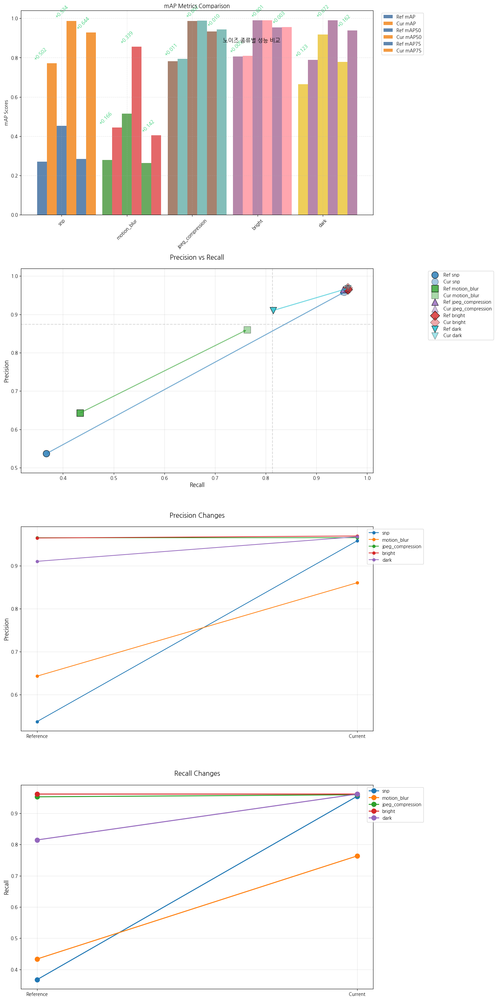


전체 성능 결과:
      noise_type model_type    mAP  mAP50  mAP75  precision  recall
             snp  Reference 0.2697 0.4525 0.2843     0.5369  0.3674
             snp    Current 0.7717 0.9863 0.9283     0.9578  0.9546
     motion_blur  Reference 0.2784 0.5157 0.2634     0.6428  0.4335
     motion_blur    Current 0.4440 0.8550 0.4051     0.8603  0.7635
jpeg_compression  Reference 0.7826 0.9873 0.9328     0.9650  0.9530
jpeg_compression    Current 0.7936 0.9890 0.9431     0.9653  0.9595
          bright  Reference 0.8053 0.9896 0.9537     0.9646  0.9618
          bright    Current 0.8099 0.9902 0.9565     0.9692  0.9617
            dark  Reference 0.6649 0.9174 0.7778     0.9102  0.8148
            dark    Current 0.7879 0.9895 0.9394     0.9676  0.9617


In [21]:
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np

def load_and_clean_results(csv_path):
    results_df = pd.read_csv(csv_path)
    
    # 수치형 컬럼 처리
    numeric_columns = ['mAP', 'mAP50', 'mAP75', 'precision', 'recall']
    for col in numeric_columns:
        # 문자열이면 숫자 추출, 이미 숫자면 그대로 사용
        if results_df[col].dtype == 'object':  # 문자열인 경우
            results_df[col] = results_df[col].str.extract(r'(\d+\.?\d*)').astype(float)
        else:  # 이미 숫자인 경우
            results_df[col] = results_df[col].astype(float)
    
    return results_df

# 결과 불러오기
results_df = load_and_clean_results("./logs/tlpdr_noise_variations/evaluation_results.csv")

# 시각화
plt.rc('font', family='NanumGothic')
fig = plot_comprehensive_comparison(results_df)
plt.show()

# 전체 결과 출력
print("\n전체 성능 결과:")
print(results_df.round(4).to_string(index=False))